Install the required libraries

In [ ]:
!pip install umap-learn

     |████████████████████████████████| 88 kB 3.6 MB/s 
     |████████████████████████████████| 1.1 MB 11.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=4b0a46cb76a824ec16f8576f15081968cf5a523d8db556f72923df5cfa0b8784
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.6-py3-none-any.whl size=53943 sha256=96659eb9ea54d7851440c7d4c853099116e5e22ddc117a7ee42136b892578752
  Stored in directory: /root/.cache/pip/wheels/03/f1/56/f80d72741e400345b5a5b50ec3d929aca581bf45e0225d5c50
Successfully built umap-learn pynndescent


In [ ]:
!pip install umap-learn[plot]

     |████████████████████████████████| 18.2 MB 462 kB/s 
     |████████████████████████████████| 76 kB 3.8 MB/s 
     |████████████████████████████████| 837 kB 8.0 MB/s 
     |████████████████████████████████| 136 kB 44.5 MB/s 
     |████████████████████████████████| 830 kB 45.1 MB/s 
     |████████████████████████████████| 822 kB 46.8 MB/s 
     |████████████████████████████████| 802 kB 46.0 MB/s 
     |████████████████████████████████| 802 kB 35.3 MB/s 
     |████████████████████████████████| 793 kB 48.0 MB/s 
     |████████████████████████████████| 793 kB 31.3 MB/s 
     |████████████████████████████████| 791 kB 50.5 MB/s 
     |████████████████████████████████| 786 kB 45.1 MB/s 
     |████████████████████████████████| 779 kB 20.6 MB/s 
     |████████████████████████████████| 778 kB 45.5 MB/s 
     |████████████████████████████████| 776 kB 44.5 MB/s 
     |████████████████████████████████| 769 kB 47.4 MB/s 
     |████████████████████████████████| 766 kB 40.1 MB/s 
     |███████████

In [ ]:
!pip install hdbscan

     |████████████████████████████████| 5.2 MB 5.3 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.28-cp37-cp37m-linux_x86_64.whl size=2330865 sha256=e9ed9c7fb99f89e866a9ebe05d9f1cf21803b6b6f070a2f24651537fc07265a6
  Stored in directory: /root/.cache/pip/wheels/6e/7a/5e/259ccc841c085fc41b99ef4a71e896b62f5161f2bc8a14c97a
Successfully built hdbscan


Import the required Libraries

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import umap
import umap.plot

from sklearn import metrics
from collections import Counter

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

Import the preprocessed data

In [ ]:
df = pd.read_csv('../data/preprocessed-data.csv')

In [ ]:
df.head()

,label,text
0,rec.sport.hockey,pens fans pretty confused lack kind posts rece...
1,comp.sys.ibm.pc.hardware,brother market high performance video card sup...
2,talk.politics.mideast,finally dream mediterranean area greater holoc...
3,comp.sys.ibm.pc.hardware,scsi card doing dma transfers disks scsi card ...
4,comp.sys.mac.hardware,[number] old drive cannot understanding driver...


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18270 entries, 0 to 18269
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   label   18270 non-null  object
 1   text    18270 non-null  object
dtypes: object(2)
memory usage: 285.6+ KB


Use the Google Sentence Encoder to create sentence embeddings for each of the preprocessed document

In [ ]:
module_url = "https://tfhub.dev/google/universal-sentence-encoder/4"
model = hub.load(module_url)
print ("module %s loaded" % module_url)

module https://tfhub.dev/google/universal-sentence-encoder/4 loaded


In [ ]:
def embed(input):
  return model([input])

In [ ]:
df['sentence_embedding'] = df['text'].apply(embed)

In [ ]:
df.head()

,label,text,sentence_embedding
0,rec.sport.hockey,pens fans pretty confused lack kind posts rece...,"((tf.Tensor(-0.039444264, shape=(), dtype=floa..."
1,comp.sys.ibm.pc.hardware,brother market high performance video card sup...,"((tf.Tensor(-0.039467372, shape=(), dtype=floa..."
2,talk.politics.mideast,finally dream mediterranean area greater holoc...,"((tf.Tensor(-0.057665747, shape=(), dtype=floa..."
3,comp.sys.ibm.pc.hardware,scsi card doing dma transfers disks scsi card ...,"((tf.Tensor(0.048537795, shape=(), dtype=float..."
4,comp.sys.mac.hardware,[number] old drive cannot understanding driver...,"((tf.Tensor(-0.05286335, shape=(), dtype=float..."


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18270 entries, 0 to 18269
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   label               18270 non-null  object
 1   text                18270 non-null  object
 2   sentence_embedding  18270 non-null  object
dtypes: object(3)
memory usage: 428.3+ KB


In [ ]:
X = df.iloc[:,2].values
X[0].shape

TensorShape([1, 512])

In [ ]:
X_new = np.array([x.numpy() for x in X]).reshape((df.shape[0],512))

In [ ]:
X_new.shape

(18270, 512)

Create a UMAP embedding from the sentence embedding vectors

In [ ]:
embedding = umap.UMAP(n_components=2).fit(X_new)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


In [ ]:
embedding.embedding_.shape

(18270, 2)

## Clustering

Import the Clustering models

In [ ]:
from sklearn import metrics
from numpy import unique
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import Birch
from sklearn.cluster import SpectralClustering

In [ ]:
sns.set(style = "darkgrid")

In [ ]:
import colorcet as cc
palette = sns.color_palette(cc.glasbey, n_colors=20)

K-Means Clustering

In [ ]:
%%time
km = KMeans(n_clusters=20, init='k-means++', max_iter=5, random_state=42)
km.fit(X_new)

CPU times: user 20.8 s, sys: 6.76 s, total: 27.5 s
Wall time: 14.2 s


In [ ]:
km.labels_

array([13, 18, 14, ..., 18,  7, 17], dtype=int32)

In [ ]:
Counter(km.labels_)

Counter({0: 1342,
         1: 850,
         2: 868,
         3: 864,
         4: 797,
         5: 824,
         6: 1184,
         7: 836,
         8: 333,
         9: 515,
         10: 750,
         11: 1491,
         12: 847,
         13: 689,
         14: 515,
         15: 495,
         16: 1803,
         17: 1179,
         18: 1145,
         19: 943})

Plot the clusters obtained in K-Means using UMAP

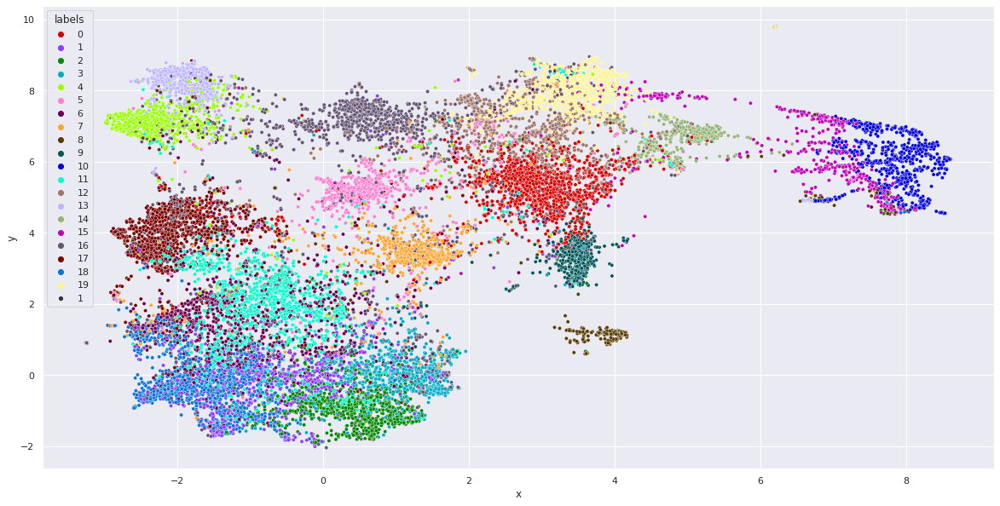

In [ ]:
# Prepare data
umap_data = embedding.fit_transform(X_new)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = km.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
sns.scatterplot(data=result, x="x", y="y", hue="labels", size=1, palette=palette)

In [ ]:
print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, km.labels_))
print("Completeness: %0.3f" % metrics.completeness_score(df.label, km.labels_))
print("V-measure: %0.3f" % metrics.v_measure_score(df.label, km.labels_))
print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, km.labels_))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_new, km.labels_, sample_size=1000))

Homogeneity: 0.406
Completeness: 0.416
V-measure: 0.411
Adjusted Rand-Index: 0.240
Silhouette Coefficient: 0.017


In [ ]:
%%time
km = KMeans(n_clusters=20, init='k-means++', max_iter=5, random_state=42)
km.fit(umap_data)

CPU times: user 901 ms, sys: 10.6 ms, total: 912 ms
Wall time: 563 ms


In [ ]:
km.labels_

array([12,  6,  3, ..., 13,  0, 10], dtype=int32)

In [ ]:
Counter(km.labels_)

Counter({0: 871,
         1: 1279,
         2: 861,
         3: 736,
         4: 1241,
         5: 1159,
         6: 1638,
         7: 981,
         8: 649,
         9: 615,
         10: 1497,
         11: 774,
         12: 807,
         13: 788,
         14: 827,
         15: 968,
         16: 525,
         17: 882,
         18: 1008,
         19: 164})

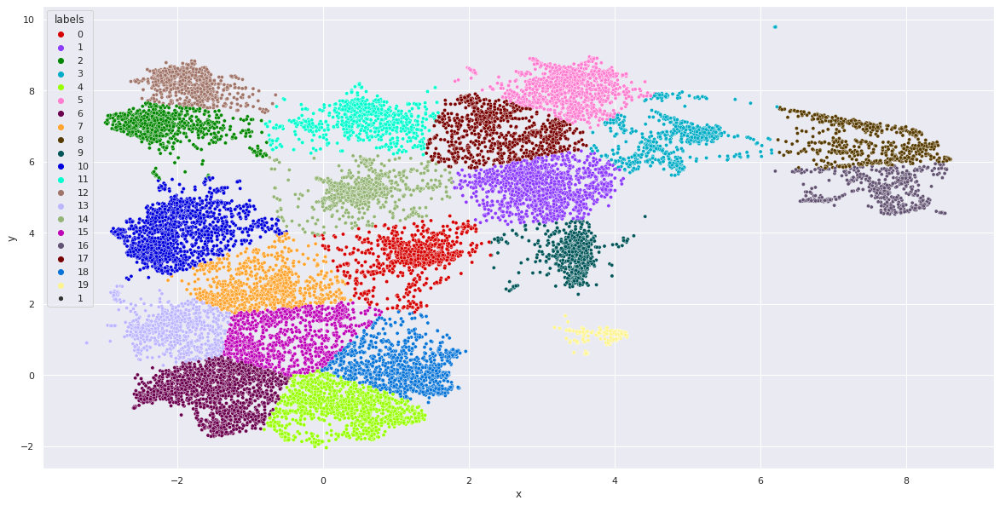

In [ ]:
# Prepare data
umap_data = umap_data
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = km.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
sns.scatterplot(data=result, x="x", y="y", hue="labels", size=1, palette=palette)

In [ ]:
print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, km.labels_))
print("Completeness: %0.3f" % metrics.completeness_score(df.label, km.labels_))
print("V-measure: %0.3f" % metrics.v_measure_score(df.label, km.labels_))
print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, km.labels_))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_new, km.labels_, sample_size=1000))

Homogeneity: 0.468
Completeness: 0.478
V-measure: 0.473
Adjusted Rand-Index: 0.328
Silhouette Coefficient: 0.012


Gaussian Mixture Model

In [ ]:
%%time
#Predict GMM cluster membership
gm_messy = GaussianMixture(n_components=20).fit(X_new).predict(X_new)

CPU times: user 3min 7s, sys: 21.1 s, total: 3min 28s
Wall time: 2min 21s


In [ ]:
Counter(gm_messy)

Counter({0: 1648,
         1: 1122,
         2: 1024,
         3: 1267,
         4: 625,
         5: 1016,
         6: 684,
         7: 527,
         8: 1018,
         9: 1351,
         10: 296,
         11: 1280,
         12: 1346,
         13: 686,
         14: 520,
         15: 677,
         16: 760,
         17: 1255,
         18: 495,
         19: 673})

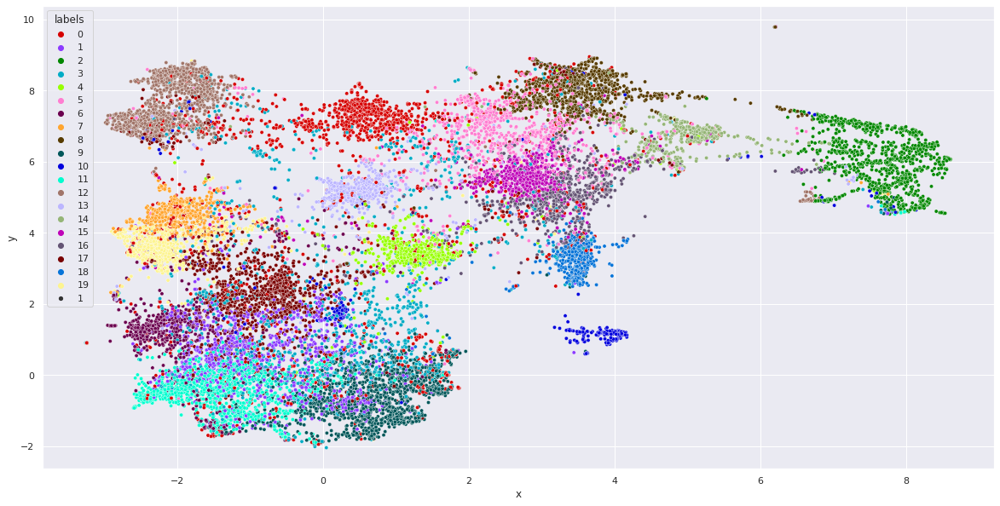

In [ ]:
# Prepare data
umap_data = umap_data
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = gm_messy

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
sns.scatterplot(data=result, x="x", y="y", hue="labels", size=1, palette=palette)

In [ ]:
print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, gm_messy))
print("Completeness: %0.3f" % metrics.completeness_score(df.label, gm_messy))
print("V-measure: %0.3f" % metrics.v_measure_score(df.label, gm_messy))
print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, gm_messy))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_new, gm_messy, sample_size=1000))

Homogeneity: 0.410
Completeness: 0.421
V-measure: 0.415
Adjusted Rand-Index: 0.238
Silhouette Coefficient: 0.026


Agglomerative Clustering

In [ ]:
%%time
model = AgglomerativeClustering(n_clusters=20)
# fit model and predict clusters
yhat = model.fit_predict(X_new)
# retrieve unique clusters
clusters = unique(yhat)
Counter(yhat)

CPU times: user 3min 1s, sys: 4.1 s, total: 3min 6s
Wall time: 3min 57s


In [ ]:
Counter(yhat)

Counter({0: 1144,
         1: 859,
         2: 989,
         3: 1338,
         4: 1913,
         5: 1491,
         6: 1525,
         7: 549,
         8: 522,
         9: 540,
         10: 985,
         11: 835,
         12: 465,
         13: 598,
         14: 207,
         15: 339,
         16: 1849,
         17: 427,
         18: 677,
         19: 1018})

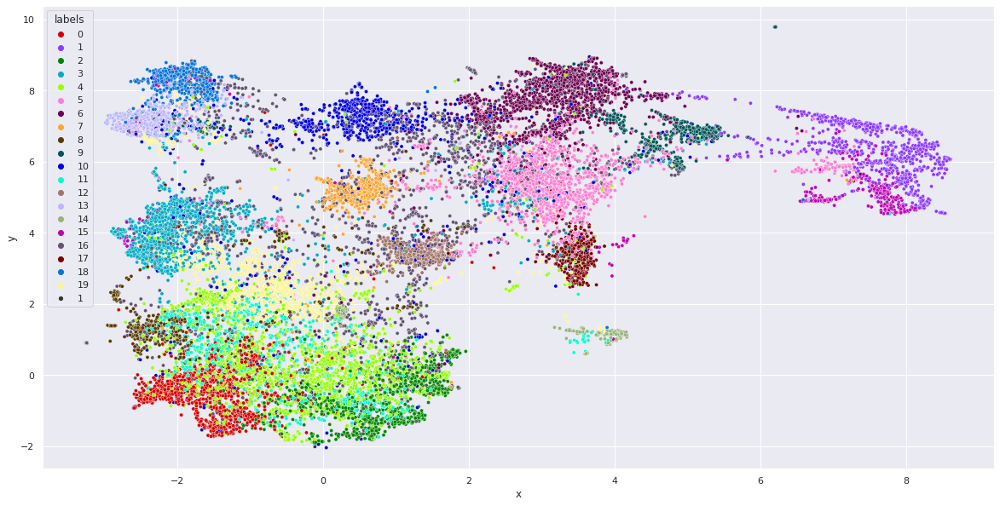

In [ ]:
# Prepare data
umap_data = umap_data
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = yhat

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
sns.scatterplot(data=result, x="x", y="y", hue="labels", size=1, palette=palette)

In [ ]:
print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, yhat))
print("Completeness: %0.3f" % metrics.completeness_score(df.label, yhat))
print("V-measure: %0.3f" % metrics.v_measure_score(df.label, yhat))
print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, yhat))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_new, yhat, sample_size=1000))

Homogeneity: 0.379
Completeness: 0.396
V-measure: 0.387
Adjusted Rand-Index: 0.206
Silhouette Coefficient: 0.008


Birch Clustering

In [ ]:
%%time
model = Birch(threshold=0.01, n_clusters=20)
# fit the model
model.fit(X_new)
# assign a cluster to each example
yhat = model.predict(X_new)
Counter(yhat)

CPU times: user 3min 15s, sys: 10.6 s, total: 3min 25s
Wall time: 3min 10s


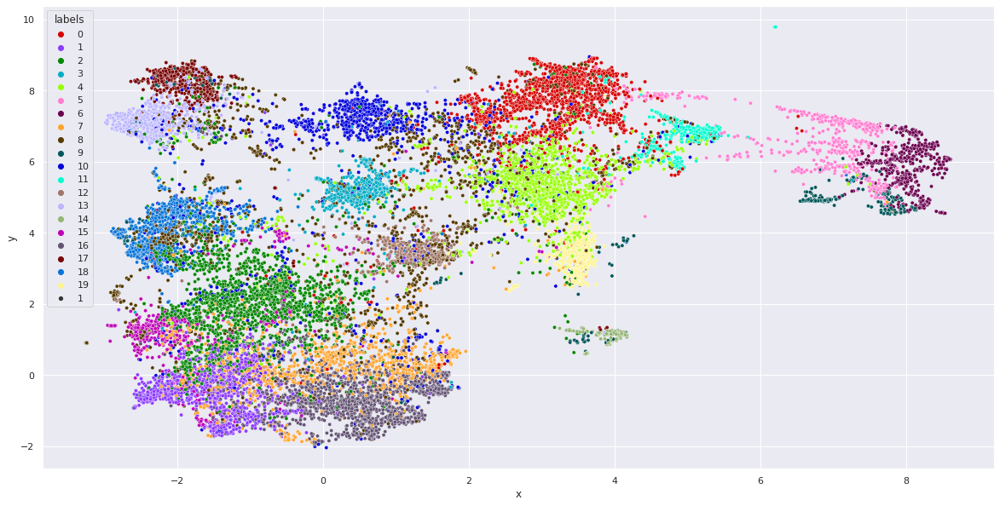

In [ ]:
# Prepare data
umap_data = umap_data
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = yhat

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
sns.scatterplot(data=result, x="x", y="y", hue="labels", size=1, palette=palette)

In [ ]:
print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, yhat))
print("Completeness: %0.3f" % metrics.completeness_score(df.label, yhat))
print("V-measure: %0.3f" % metrics.v_measure_score(df.label, yhat))
print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, yhat))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_new, yhat, sample_size=1000))

Homogeneity: 0.387
Completeness: 0.409
V-measure: 0.398
Adjusted Rand-Index: 0.218
Silhouette Coefficient: 0.003


In [ ]:
import hdbscan
clust_number = 2

hdb = hdbscan.HDBSCAN(min_cluster_size=clust_number)
cluster = hdb.fit(umap_data)

Cluster Number: 2
Homogeneity: 0.563
Completeness: 0.268
V-measure: 0.363
Adjusted Rand-Index: 0.002
Silhouette Coefficient: -0.190


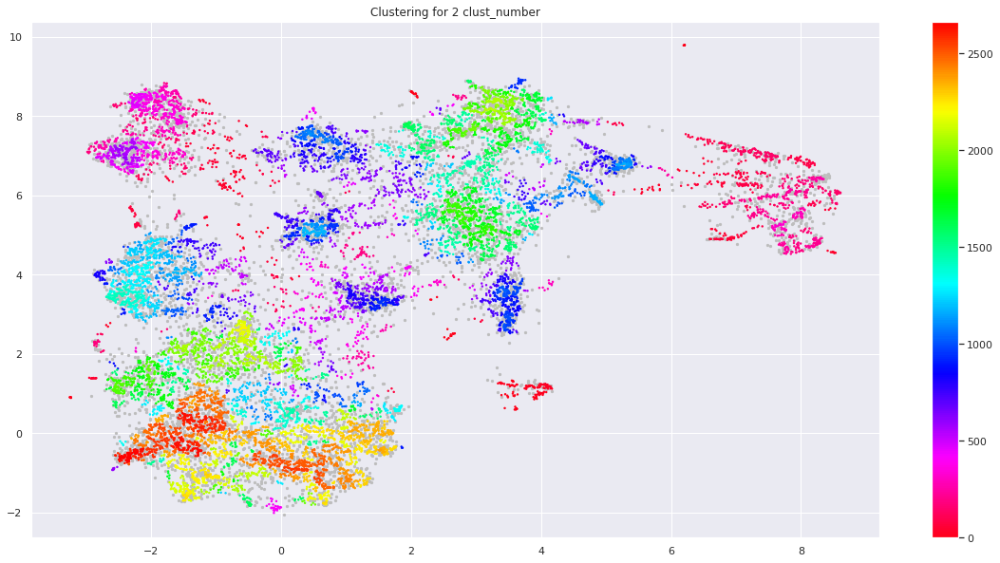

Cluster Number: 3
Homogeneity: 0.467
Completeness: 0.268
V-measure: 0.341
Adjusted Rand-Index: 0.003
Silhouette Coefficient: -0.171


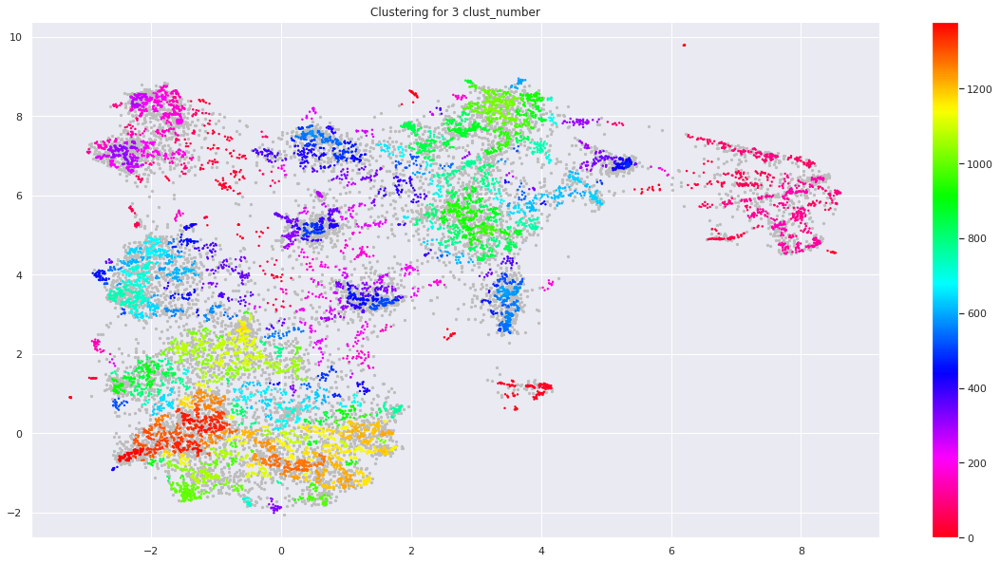

Cluster Number: 4
Homogeneity: 0.441
Completeness: 0.294
V-measure: 0.352
Adjusted Rand-Index: 0.028
Silhouette Coefficient: -0.155


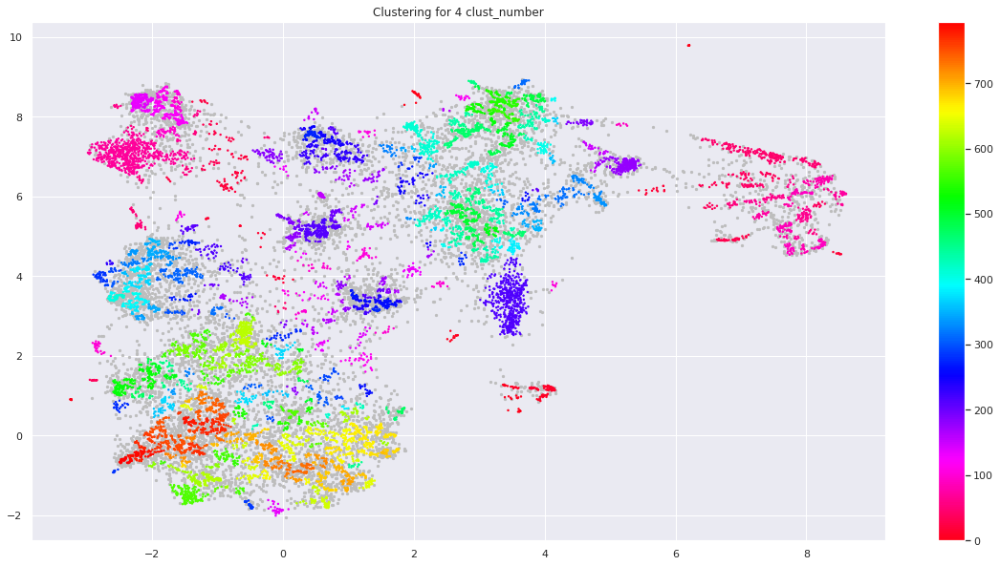

Cluster Number: 5
Homogeneity: 0.406
Completeness: 0.297
V-measure: 0.343
Adjusted Rand-Index: 0.025
Silhouette Coefficient: -0.149


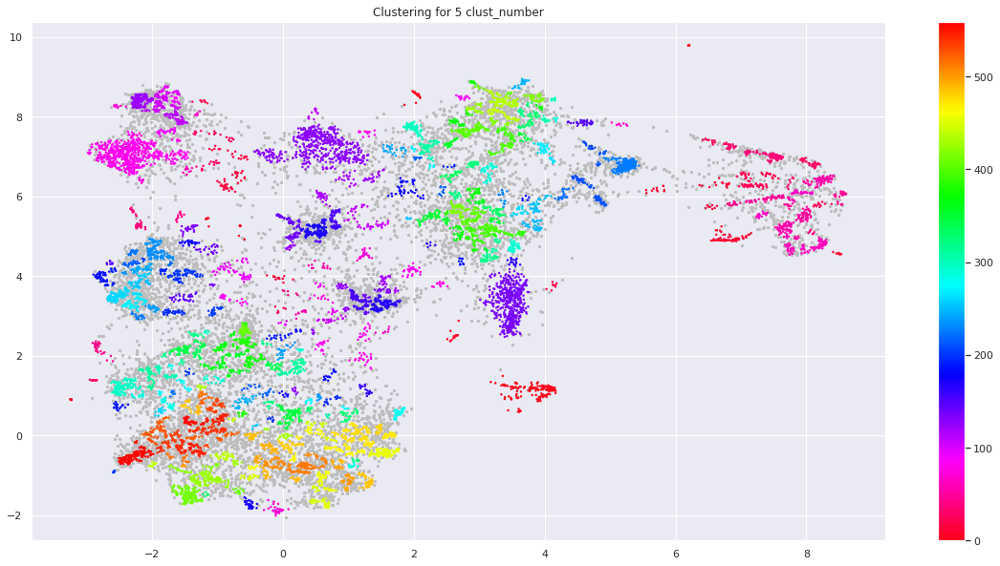

Cluster Number: 6
Homogeneity: 0.412
Completeness: 0.321
V-measure: 0.361
Adjusted Rand-Index: 0.045
Silhouette Coefficient: -0.132


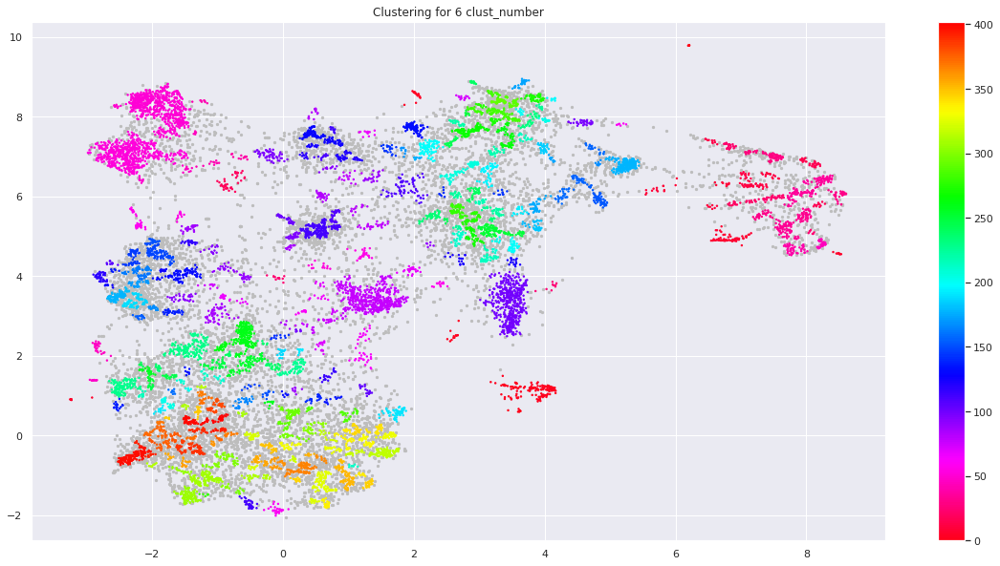

Cluster Number: 7
Homogeneity: 0.413
Completeness: 0.335
V-measure: 0.370
Adjusted Rand-Index: 0.057
Silhouette Coefficient: -0.105


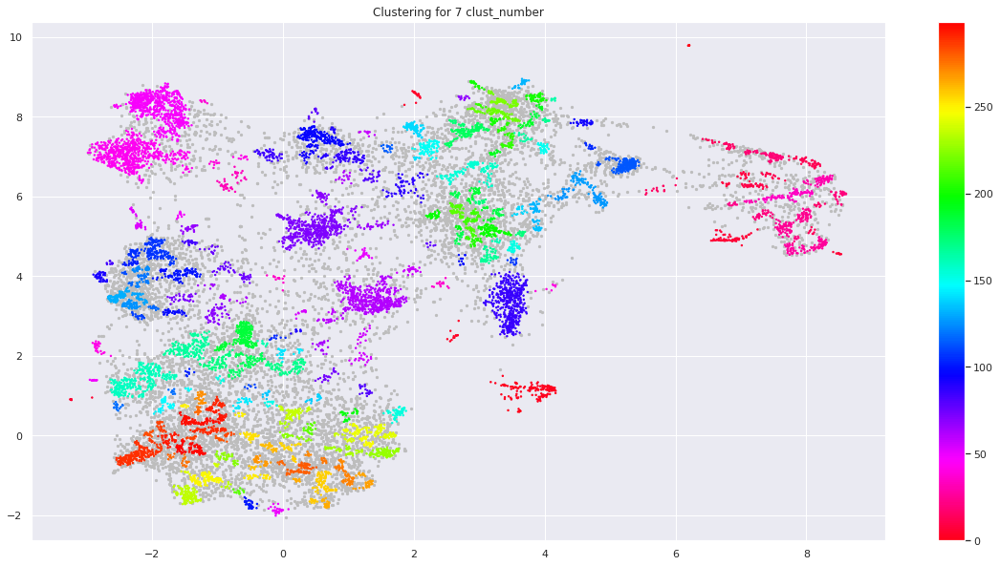

Cluster Number: 8
Homogeneity: 0.410
Completeness: 0.346
V-measure: 0.376
Adjusted Rand-Index: 0.058
Silhouette Coefficient: -0.038


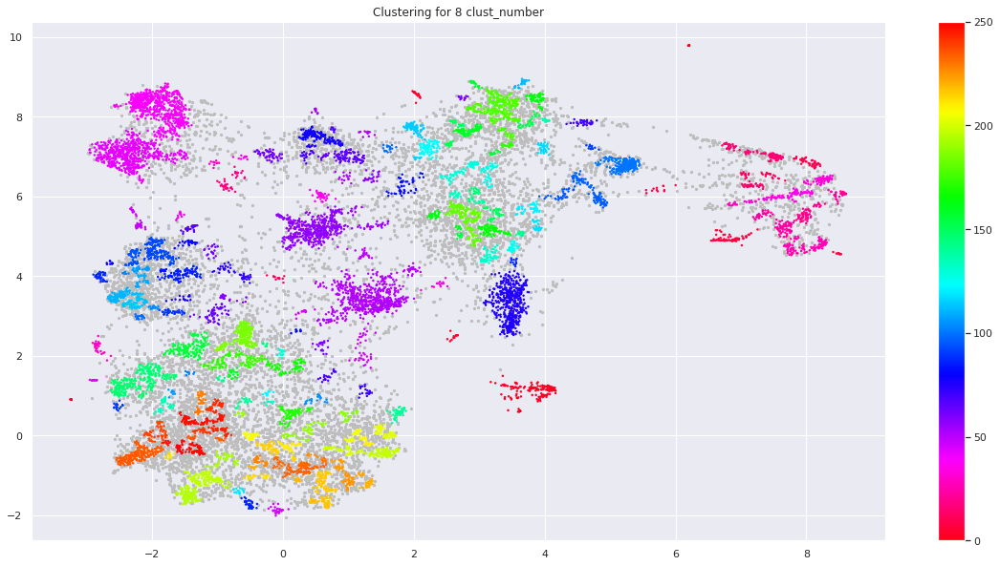

Cluster Number: 9
Homogeneity: 0.394
Completeness: 0.350
V-measure: 0.370
Adjusted Rand-Index: 0.054
Silhouette Coefficient: -0.146


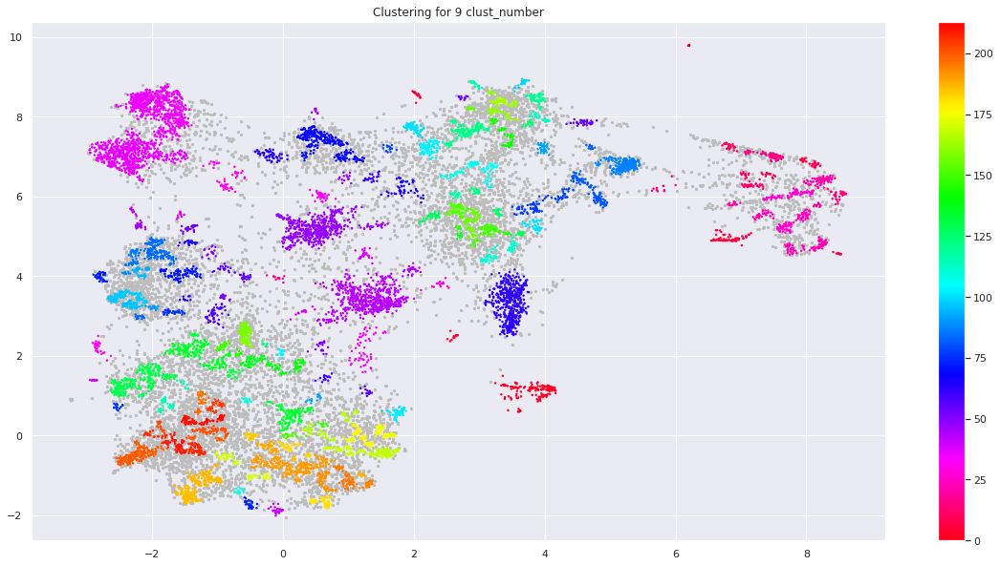

Cluster Number: 10
Homogeneity: 0.405
Completeness: 0.380
V-measure: 0.392
Adjusted Rand-Index: 0.097
Silhouette Coefficient: -0.068


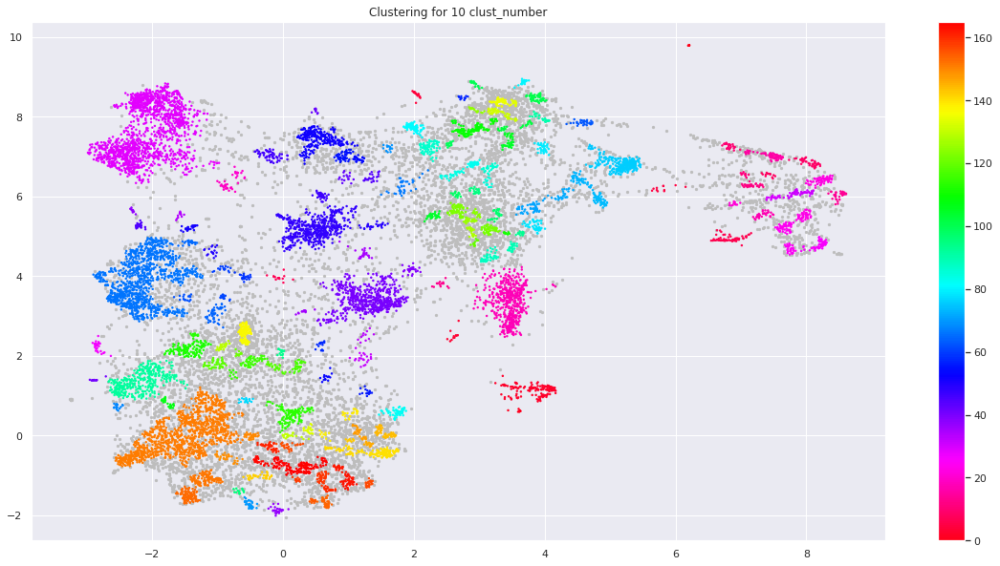

Cluster Number: 11
Homogeneity: 0.406
Completeness: 0.382
V-measure: 0.394
Adjusted Rand-Index: 0.103
Silhouette Coefficient: -0.054


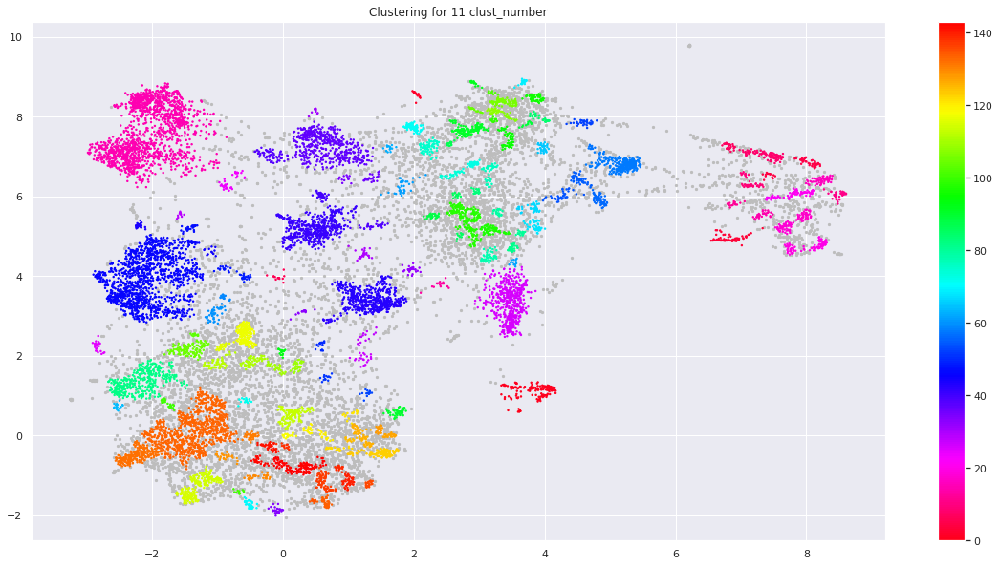

Cluster Number: 12
Homogeneity: 0.397
Completeness: 0.376
V-measure: 0.386
Adjusted Rand-Index: 0.088
Silhouette Coefficient: -0.098


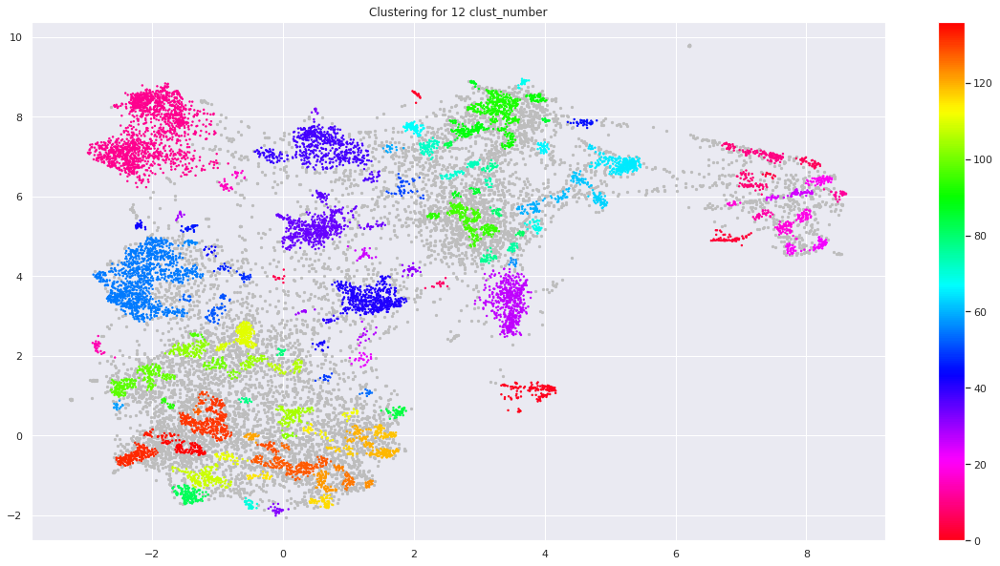

Cluster Number: 13
Homogeneity: 0.387
Completeness: 0.379
V-measure: 0.383
Adjusted Rand-Index: 0.085
Silhouette Coefficient: -0.118


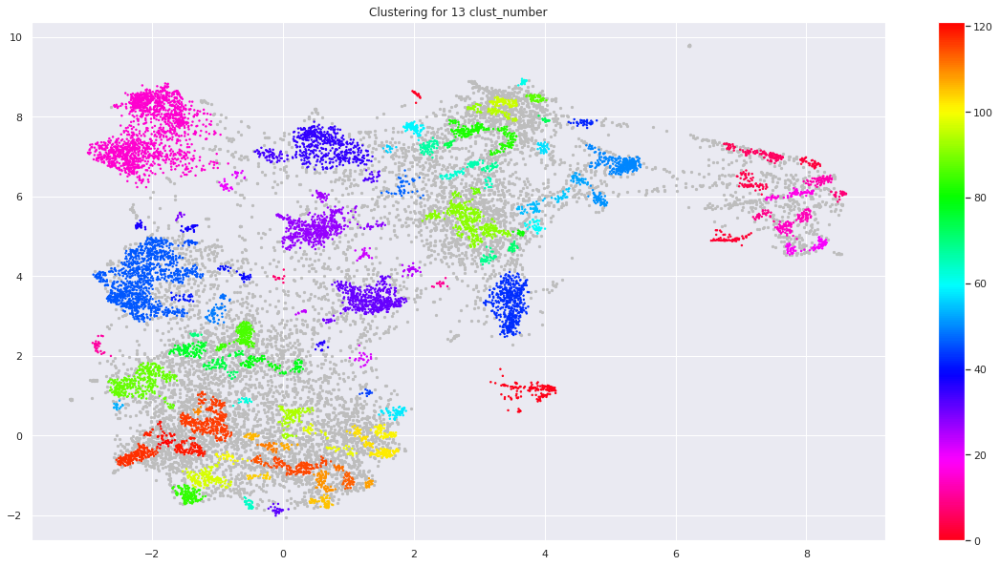

Cluster Number: 14
Homogeneity: 0.392
Completeness: 0.433
V-measure: 0.412
Adjusted Rand-Index: 0.165
Silhouette Coefficient: -0.049


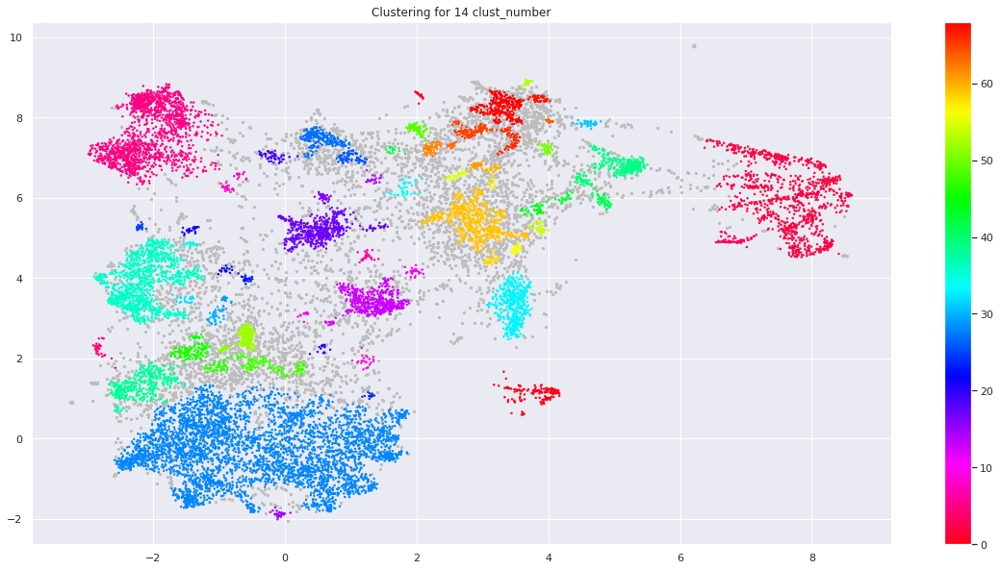

Cluster Number: 15
Homogeneity: 0.383
Completeness: 0.391
V-measure: 0.387
Adjusted Rand-Index: 0.111
Silhouette Coefficient: -0.064


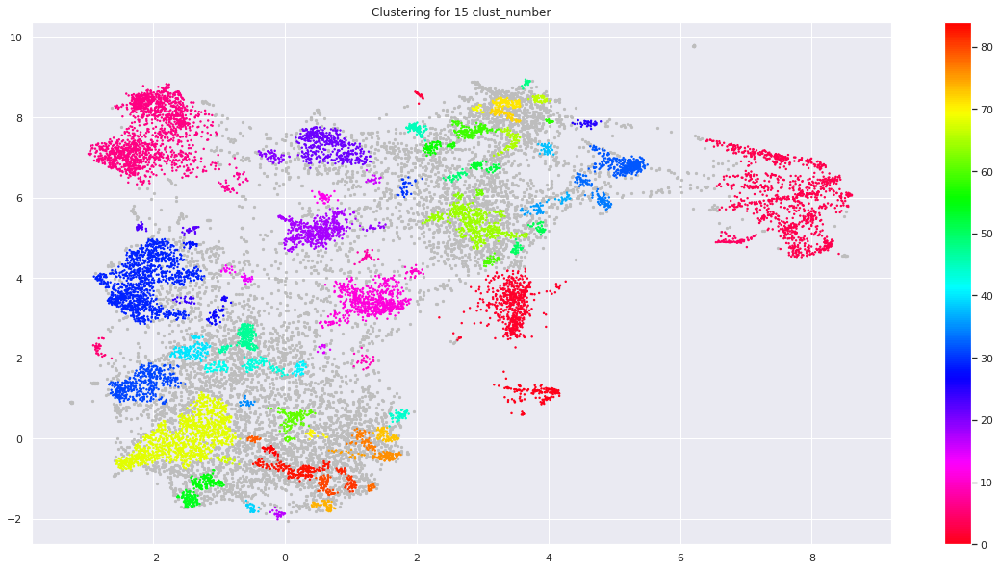

Cluster Number: 16
Homogeneity: 0.326
Completeness: 0.450
V-measure: 0.378
Adjusted Rand-Index: 0.122
Silhouette Coefficient: 0.029


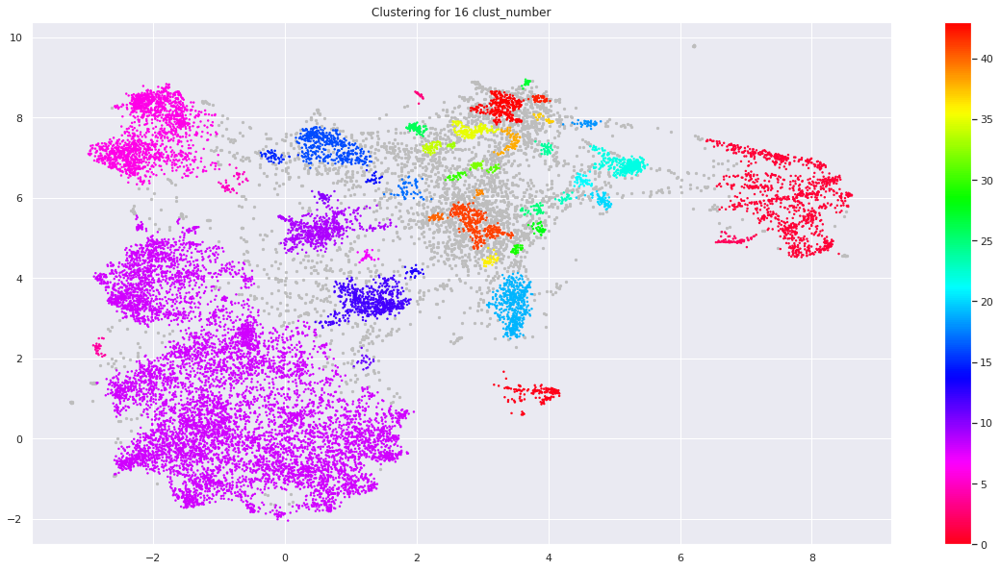

Cluster Number: 17
Homogeneity: 0.012
Completeness: 0.118
V-measure: 0.021
Adjusted Rand-Index: 0.001
Silhouette Coefficient: 0.105


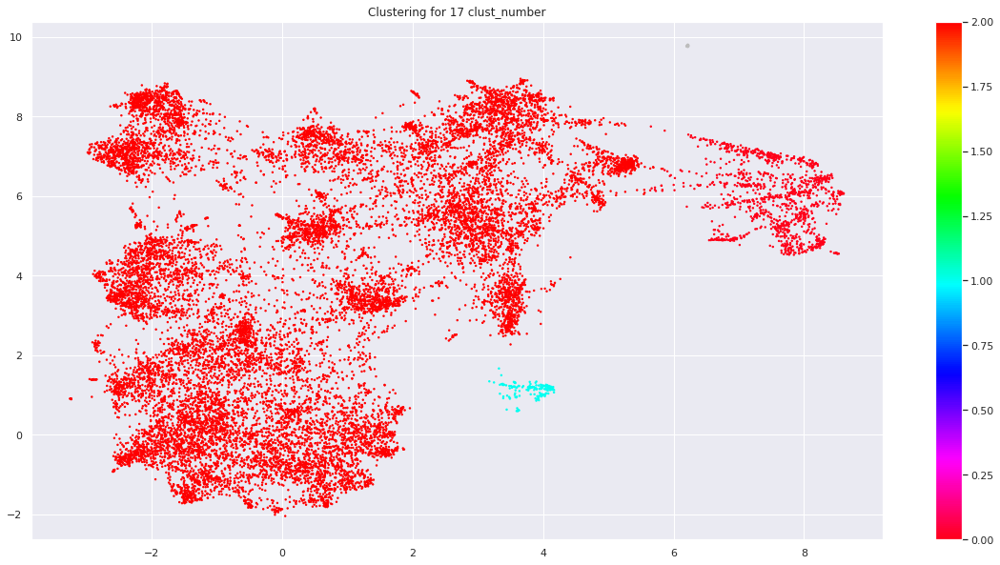

Cluster Number: 18
Homogeneity: 0.012
Completeness: 0.118
V-measure: 0.021
Adjusted Rand-Index: 0.001
Silhouette Coefficient: 0.104


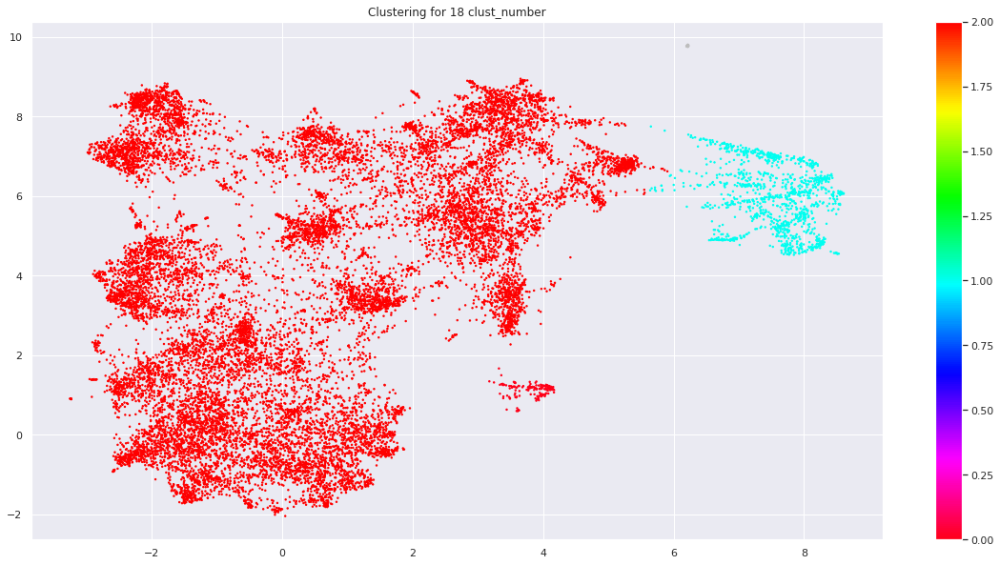

Cluster Number: 19
Homogeneity: 0.012
Completeness: 0.118
V-measure: 0.021
Adjusted Rand-Index: 0.001
Silhouette Coefficient: 0.059


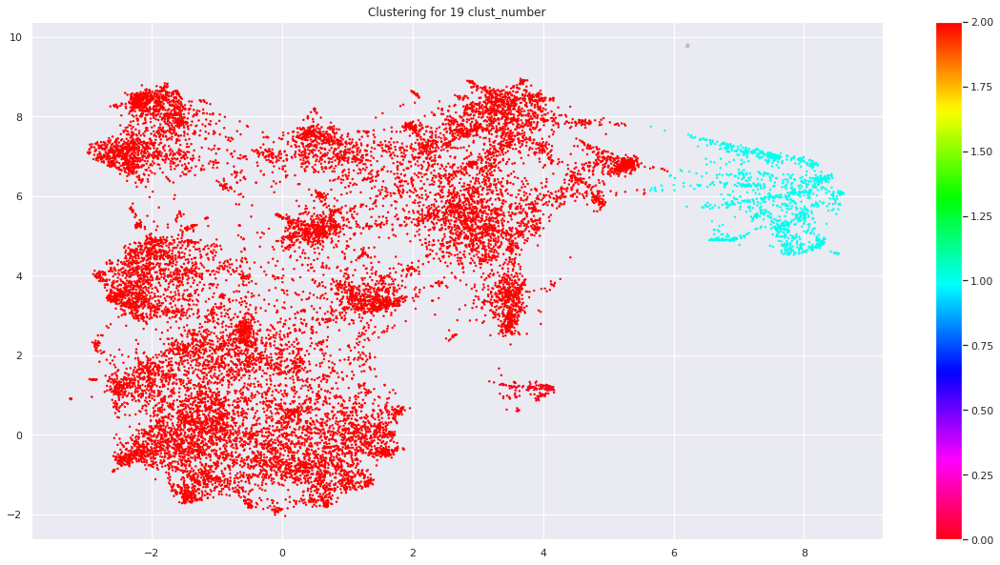

Cluster Number: 20
Homogeneity: 0.012
Completeness: 0.118
V-measure: 0.021
Adjusted Rand-Index: 0.001
Silhouette Coefficient: 0.071


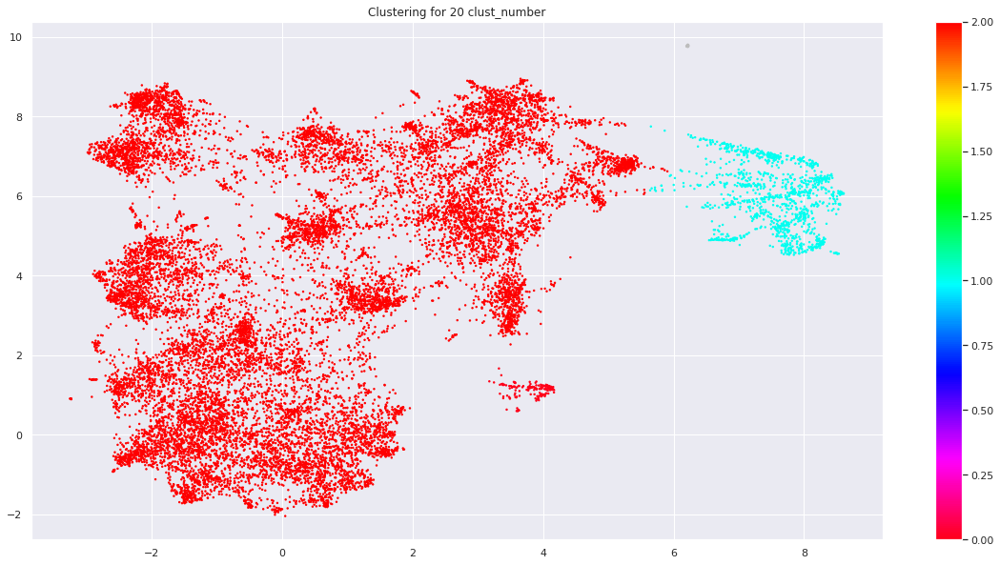

Cluster Number: 21
Homogeneity: 0.376
Completeness: 0.402
V-measure: 0.389
Adjusted Rand-Index: 0.123
Silhouette Coefficient: 0.015


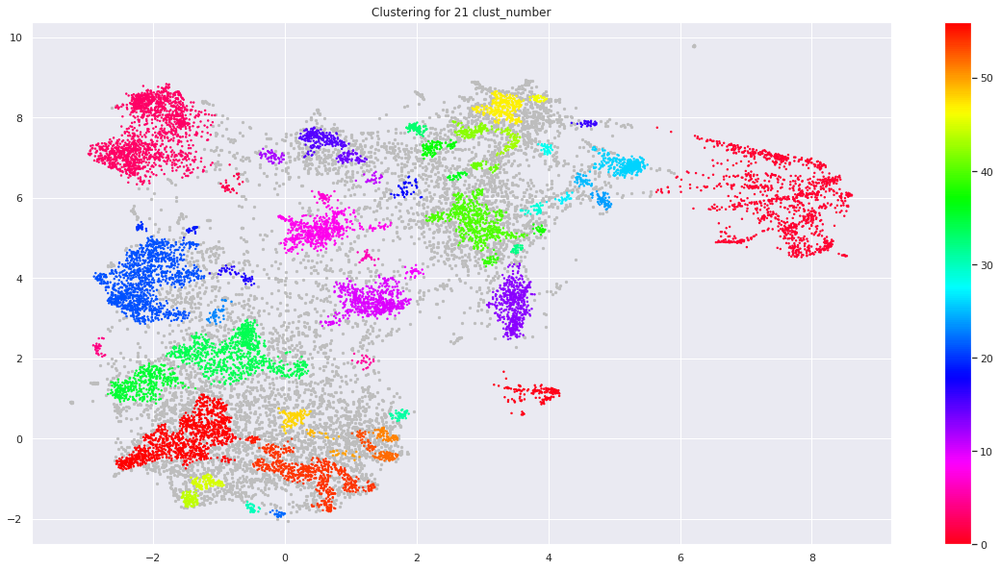

Cluster Number: 22
Homogeneity: 0.114
Completeness: 0.468
V-measure: 0.184
Adjusted Rand-Index: 0.024
Silhouette Coefficient: 0.036


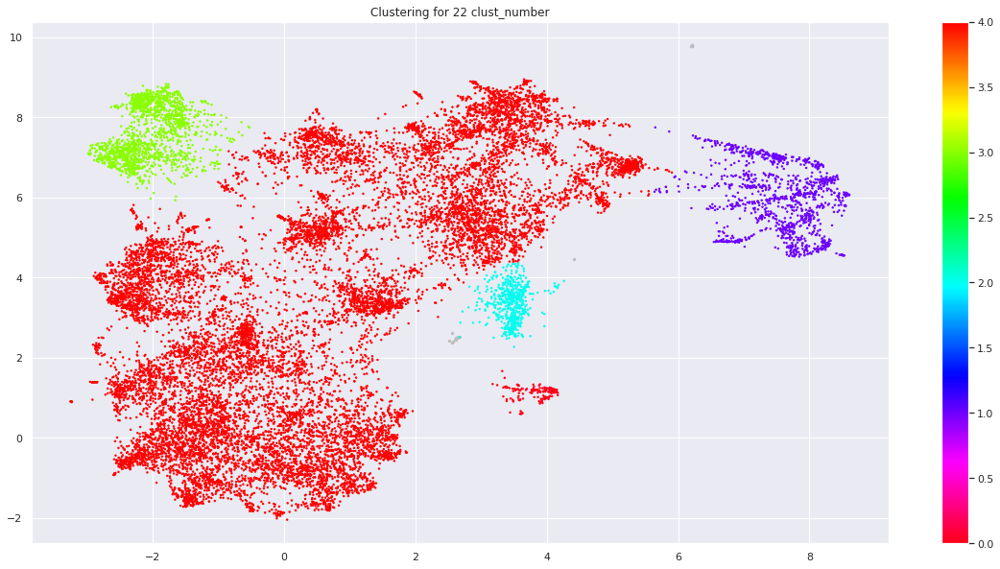

Cluster Number: 23
Homogeneity: 0.114
Completeness: 0.469
V-measure: 0.184
Adjusted Rand-Index: 0.024
Silhouette Coefficient: 0.040


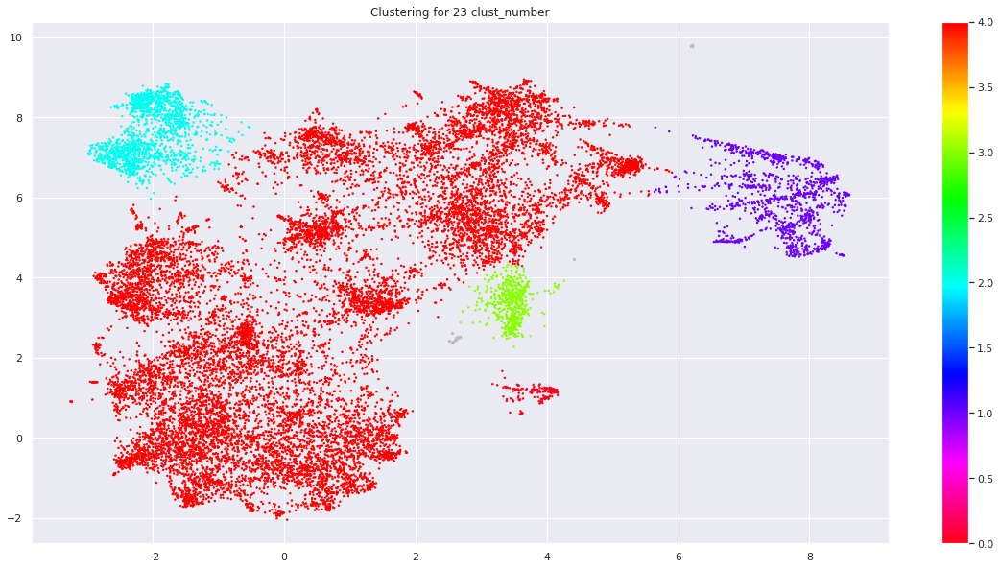

Cluster Number: 24
Homogeneity: 0.300
Completeness: 0.457
V-measure: 0.362
Adjusted Rand-Index: 0.099
Silhouette Coefficient: 0.136


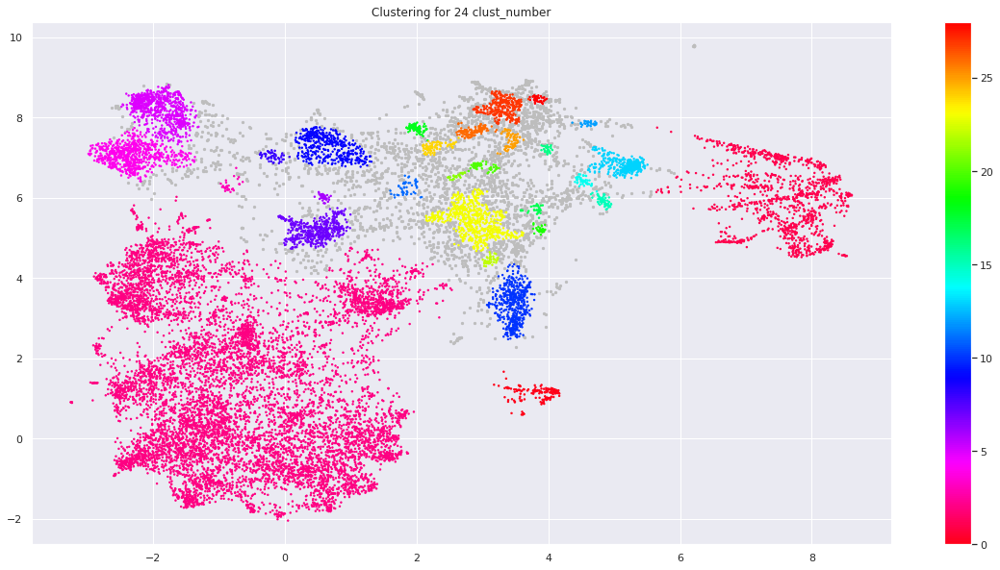

Cluster Number: 25
Homogeneity: 0.211
Completeness: 0.490
V-measure: 0.295
Adjusted Rand-Index: 0.090
Silhouette Coefficient: 0.168


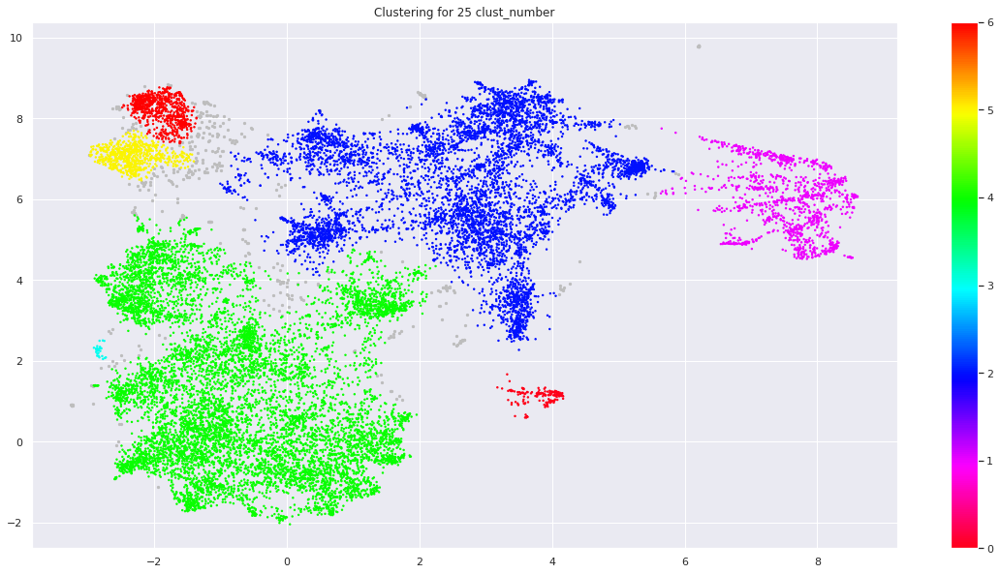

Cluster Number: 26
Homogeneity: 0.212
Completeness: 0.494
V-measure: 0.296
Adjusted Rand-Index: 0.090
Silhouette Coefficient: 0.138


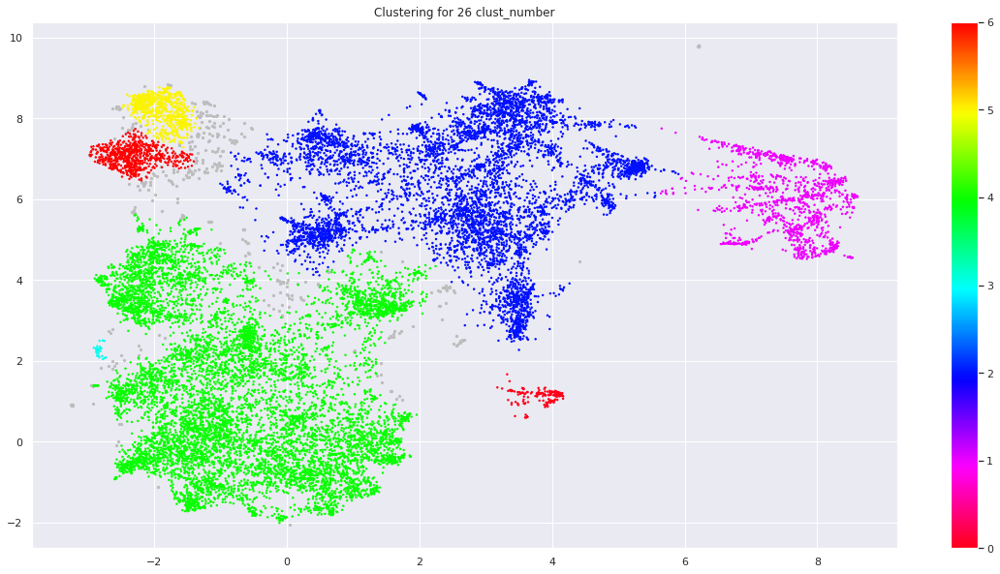

Cluster Number: 27
Homogeneity: 0.323
Completeness: 0.462
V-measure: 0.380
Adjusted Rand-Index: 0.115
Silhouette Coefficient: 0.018


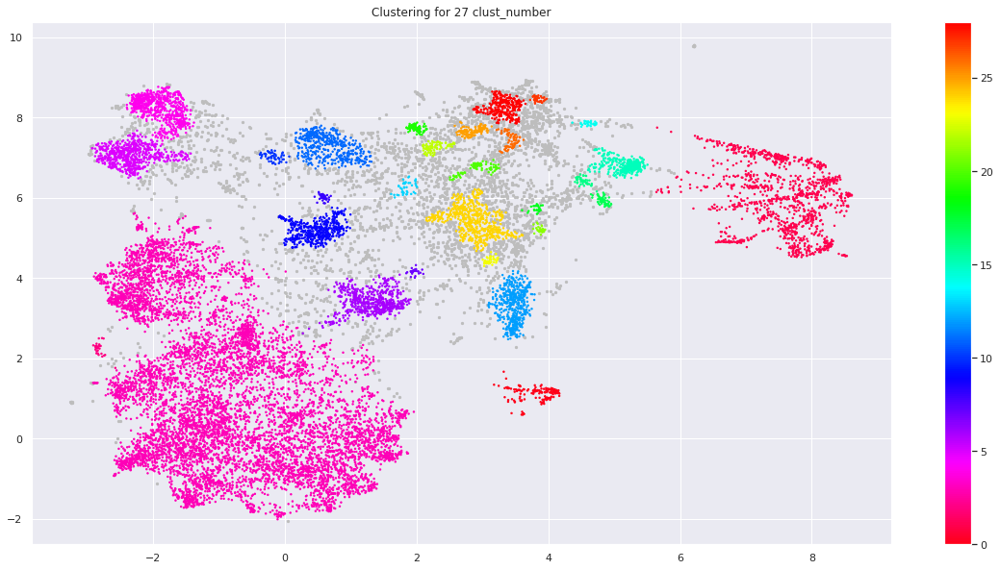

Cluster Number: 28
Homogeneity: 0.304
Completeness: 0.480
V-measure: 0.372
Adjusted Rand-Index: 0.128
Silhouette Coefficient: 0.047


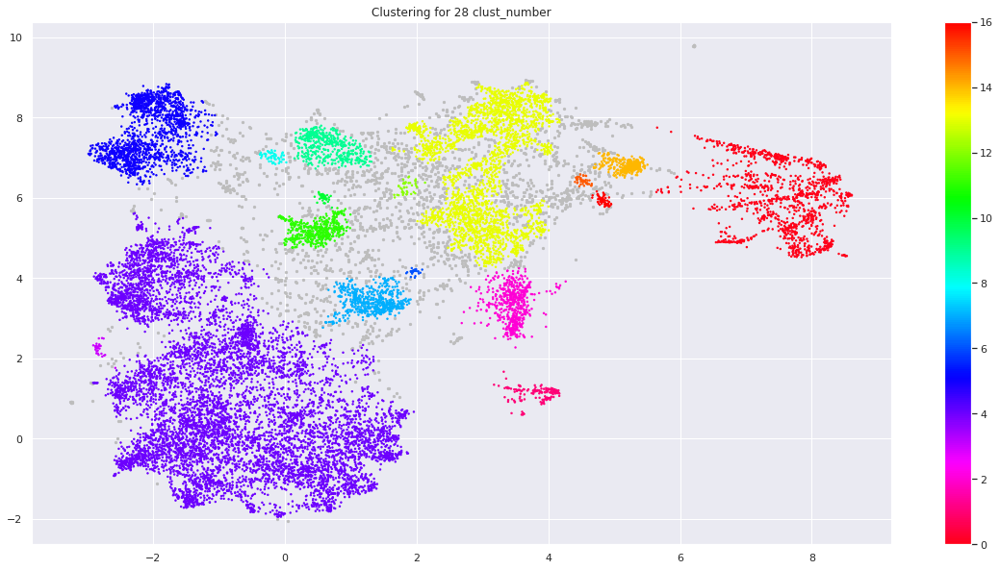

Cluster Number: 29
Homogeneity: 0.304
Completeness: 0.481
V-measure: 0.372
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.103


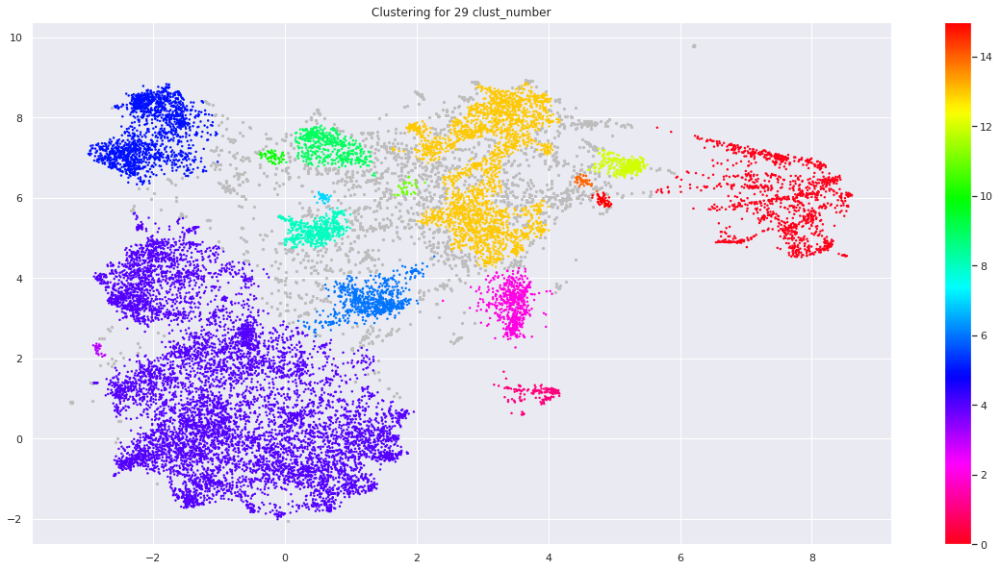

Cluster Number: 30
Homogeneity: 0.319
Completeness: 0.470
V-measure: 0.380
Adjusted Rand-Index: 0.124
Silhouette Coefficient: 0.094


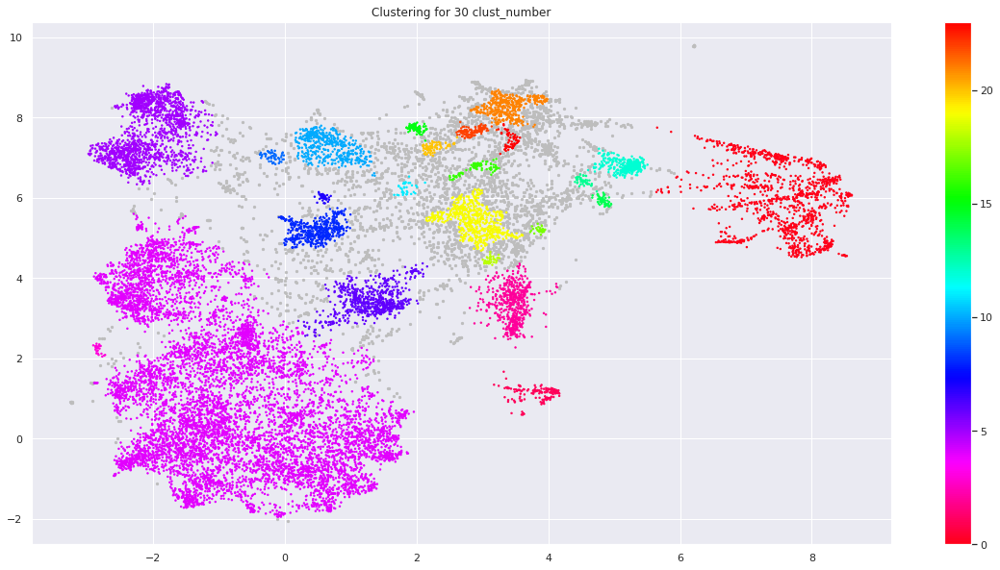

Cluster Number: 31
Homogeneity: 0.324
Completeness: 0.473
V-measure: 0.385
Adjusted Rand-Index: 0.118
Silhouette Coefficient: 0.177


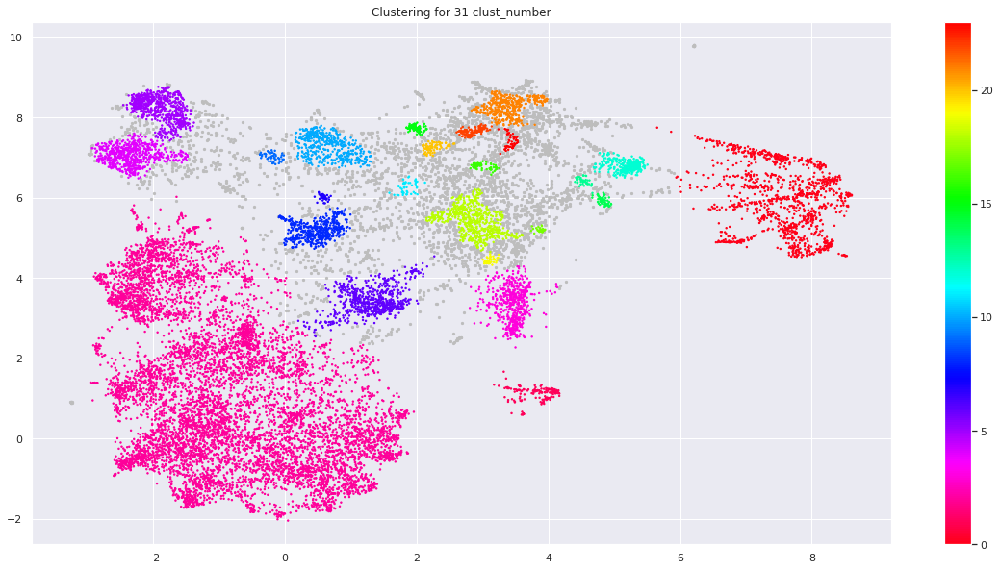

Cluster Number: 32
Homogeneity: 0.311
Completeness: 0.484
V-measure: 0.379
Adjusted Rand-Index: 0.124
Silhouette Coefficient: 0.171


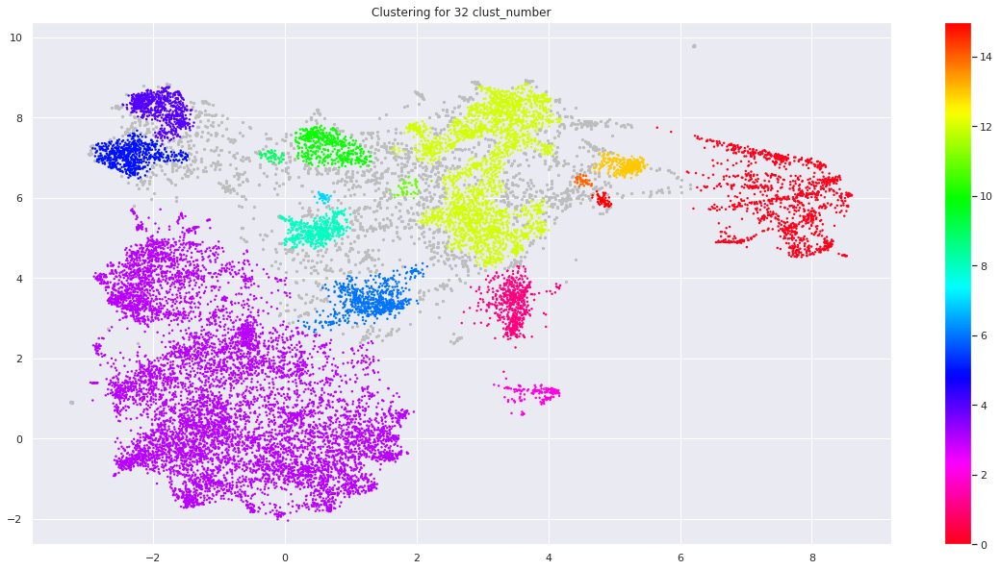

Cluster Number: 33
Homogeneity: 0.114
Completeness: 0.464
V-measure: 0.183
Adjusted Rand-Index: 0.024
Silhouette Coefficient: -0.086


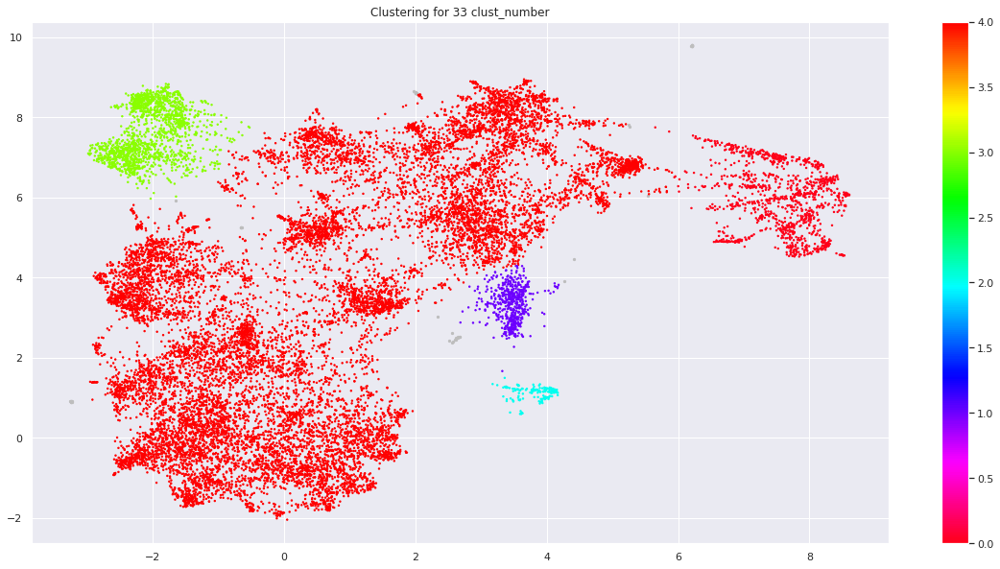

Cluster Number: 34
Homogeneity: 0.114
Completeness: 0.463
V-measure: 0.183
Adjusted Rand-Index: 0.024
Silhouette Coefficient: 0.051


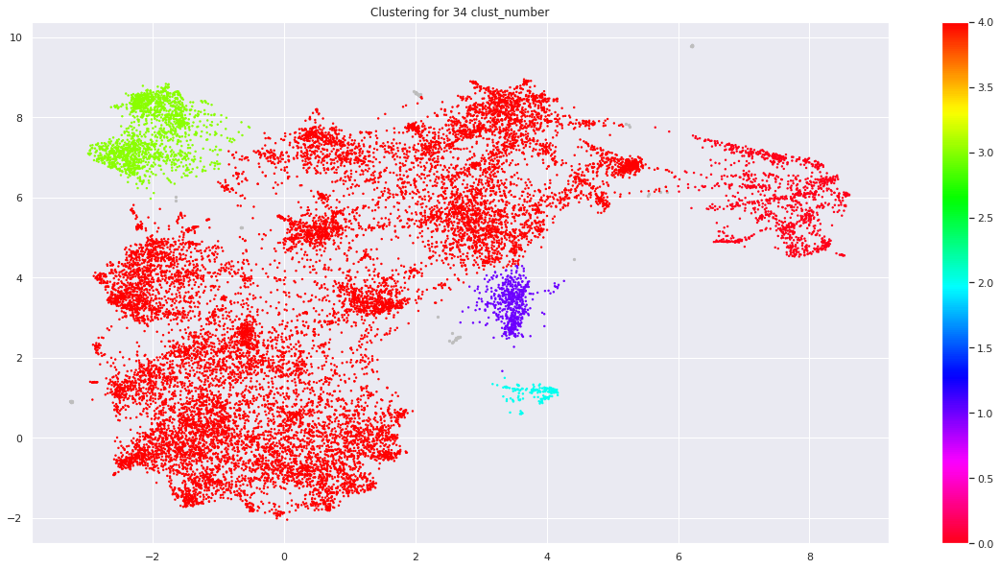

Cluster Number: 35
Homogeneity: 0.310
Completeness: 0.484
V-measure: 0.378
Adjusted Rand-Index: 0.123
Silhouette Coefficient: 0.181


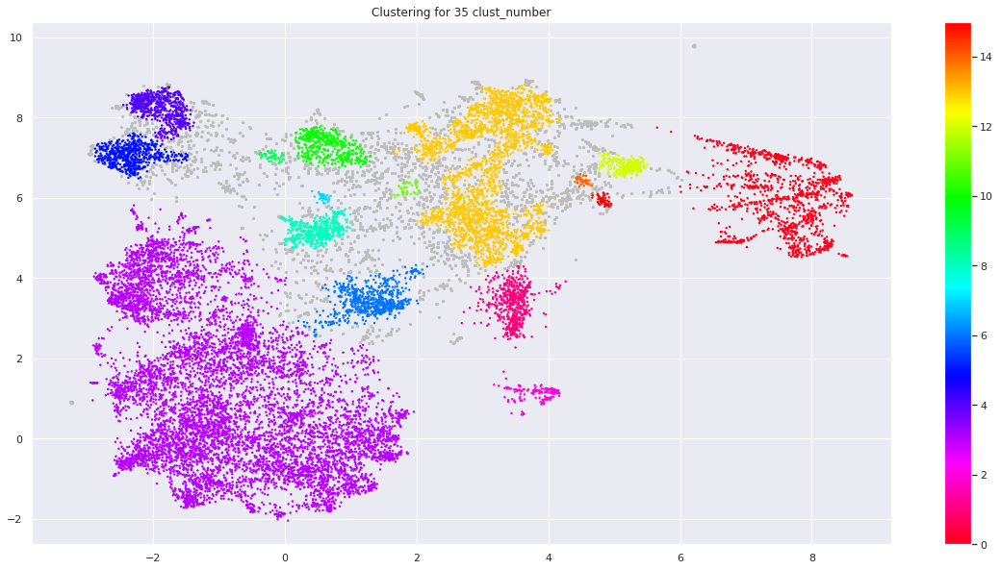

Cluster Number: 36
Homogeneity: 0.315
Completeness: 0.475
V-measure: 0.378
Adjusted Rand-Index: 0.123
Silhouette Coefficient: 0.152


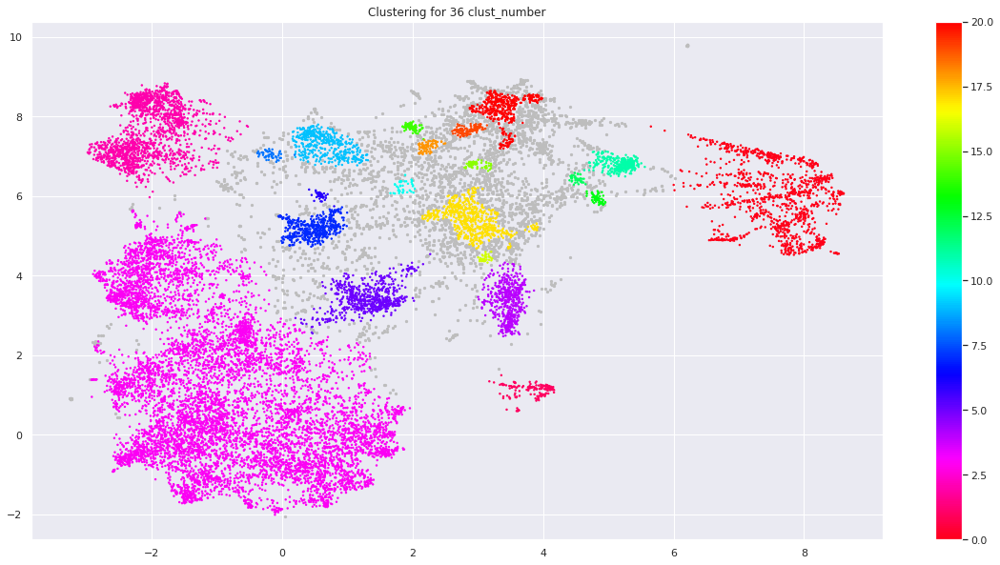

Cluster Number: 37
Homogeneity: 0.317
Completeness: 0.474
V-measure: 0.380
Adjusted Rand-Index: 0.122
Silhouette Coefficient: 0.179


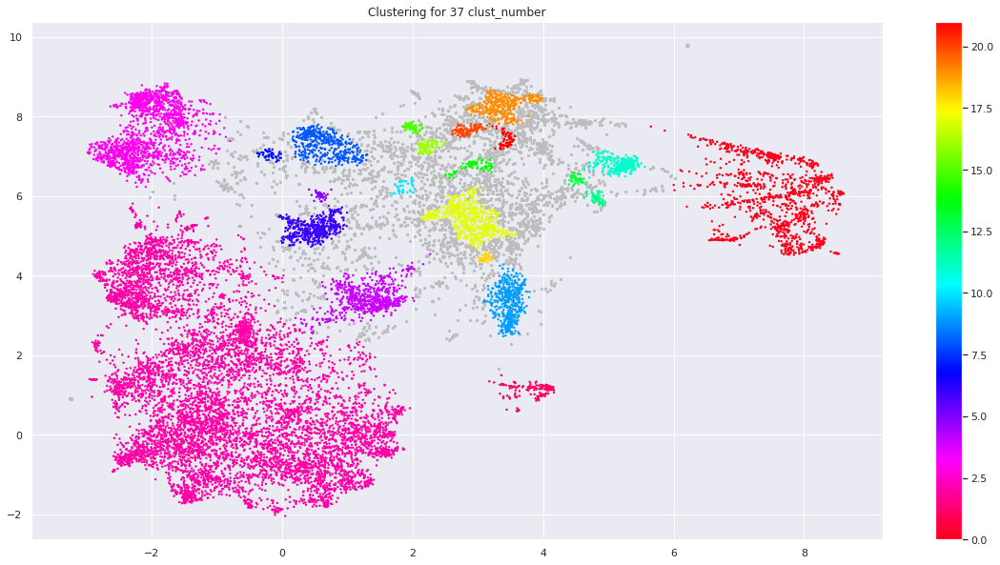

Cluster Number: 38
Homogeneity: 0.316
Completeness: 0.474
V-measure: 0.379
Adjusted Rand-Index: 0.122
Silhouette Coefficient: 0.181


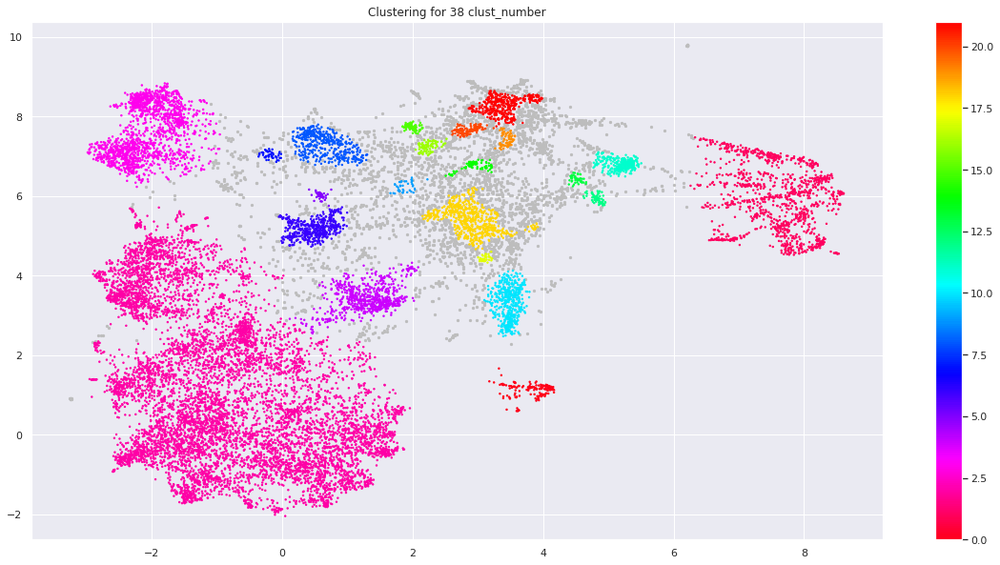

Cluster Number: 39
Homogeneity: 0.307
Completeness: 0.483
V-measure: 0.376
Adjusted Rand-Index: 0.122
Silhouette Coefficient: 0.156


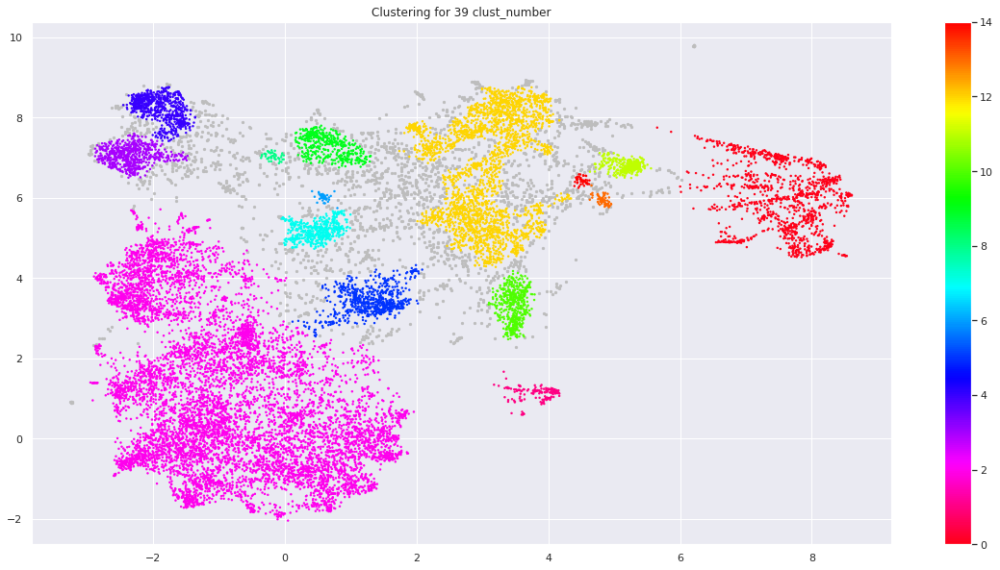

Cluster Number: 40
Homogeneity: 0.287
Completeness: 0.495
V-measure: 0.363
Adjusted Rand-Index: 0.128
Silhouette Coefficient: 0.219


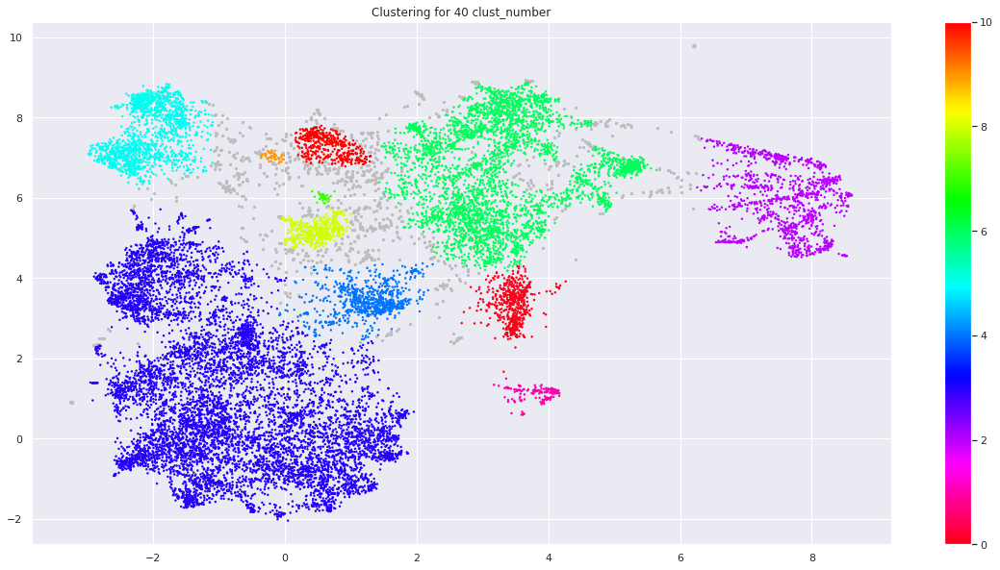

Cluster Number: 41
Homogeneity: 0.354
Completeness: 0.447
V-measure: 0.395
Adjusted Rand-Index: 0.144
Silhouette Coefficient: 0.076


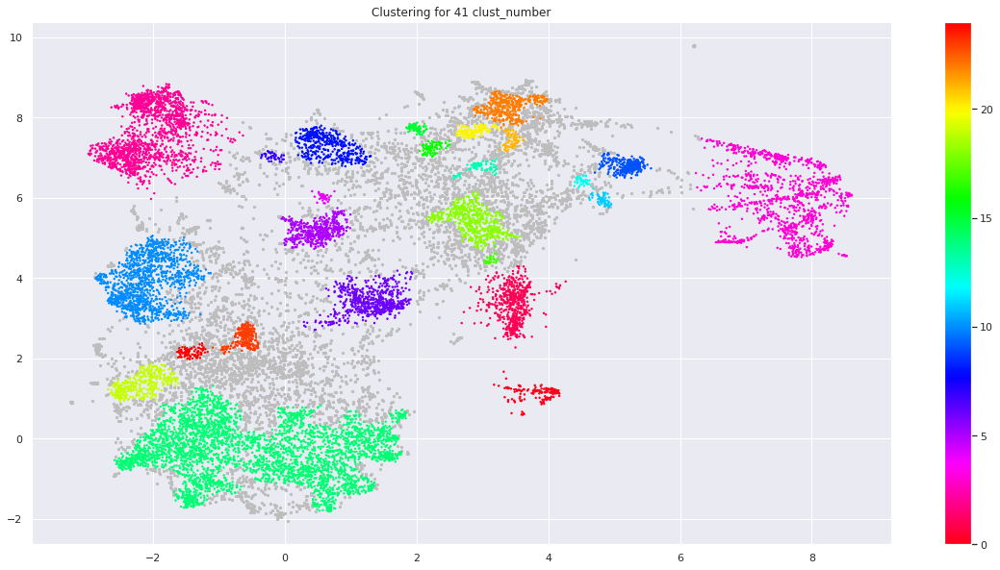

Cluster Number: 42
Homogeneity: 0.318
Completeness: 0.477
V-measure: 0.382
Adjusted Rand-Index: 0.126
Silhouette Coefficient: 0.215


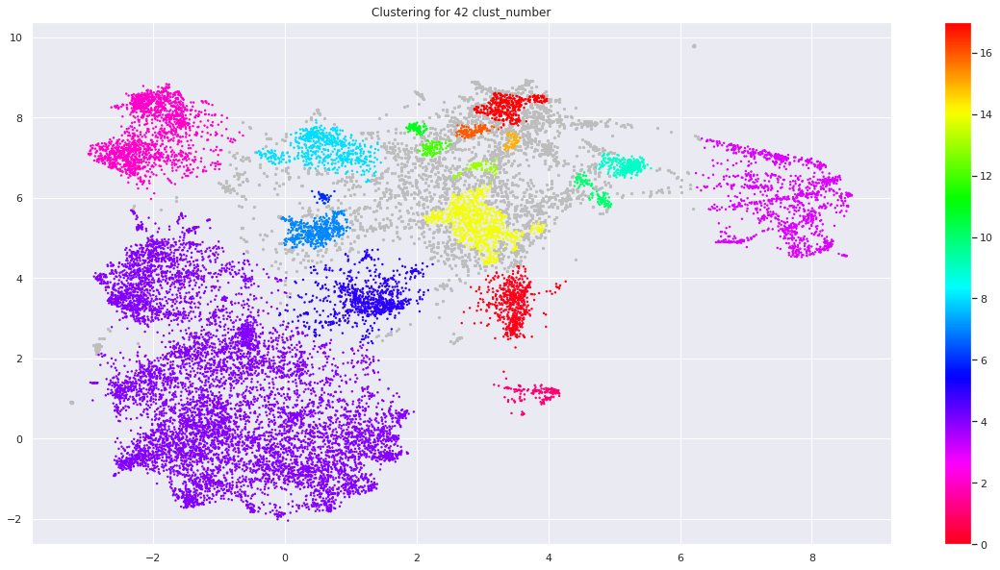

Cluster Number: 43
Homogeneity: 0.326
Completeness: 0.478
V-measure: 0.387
Adjusted Rand-Index: 0.122
Silhouette Coefficient: 0.170


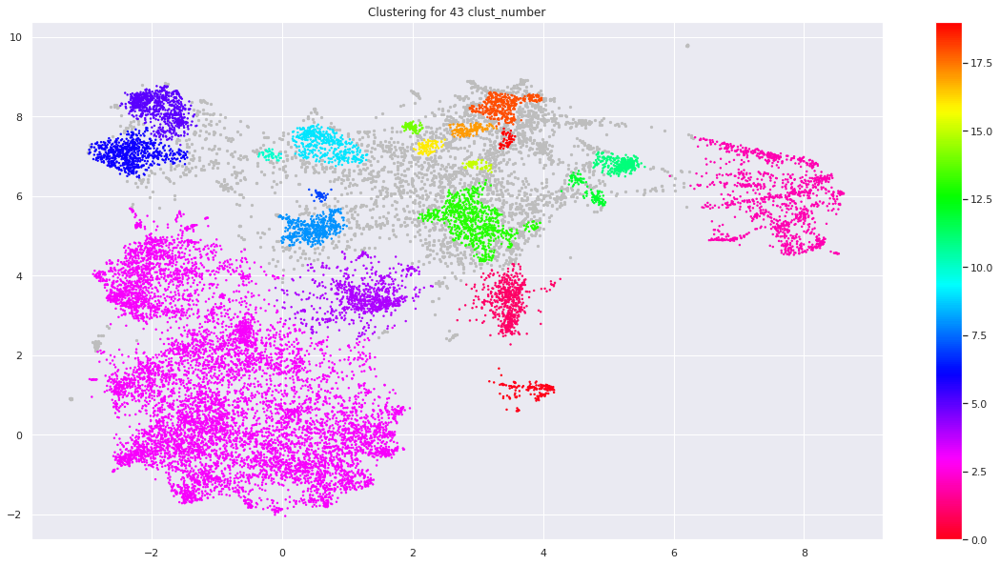

Cluster Number: 44
Homogeneity: 0.326
Completeness: 0.478
V-measure: 0.388
Adjusted Rand-Index: 0.121
Silhouette Coefficient: 0.196


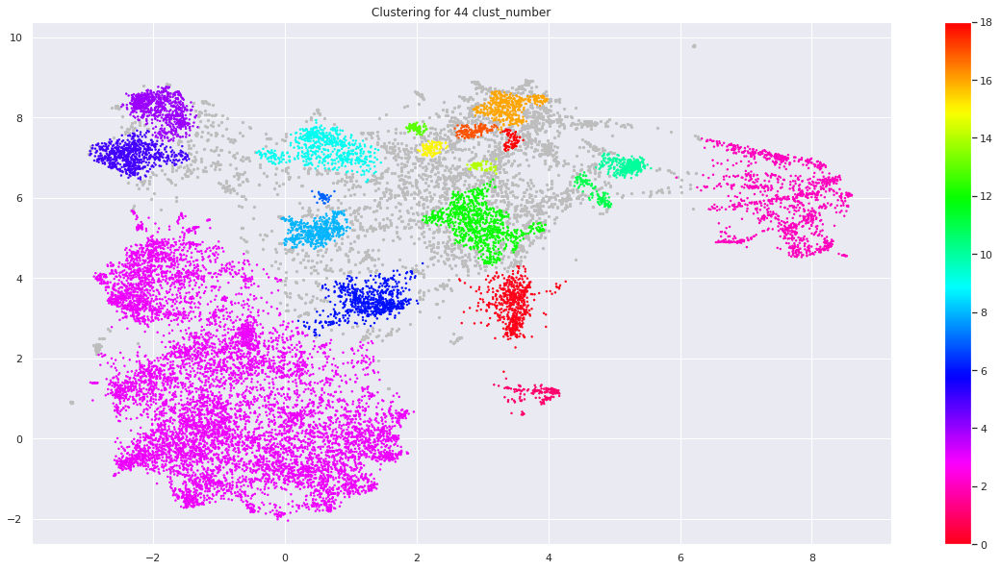

Cluster Number: 45
Homogeneity: 0.328
Completeness: 0.476
V-measure: 0.388
Adjusted Rand-Index: 0.123
Silhouette Coefficient: 0.203


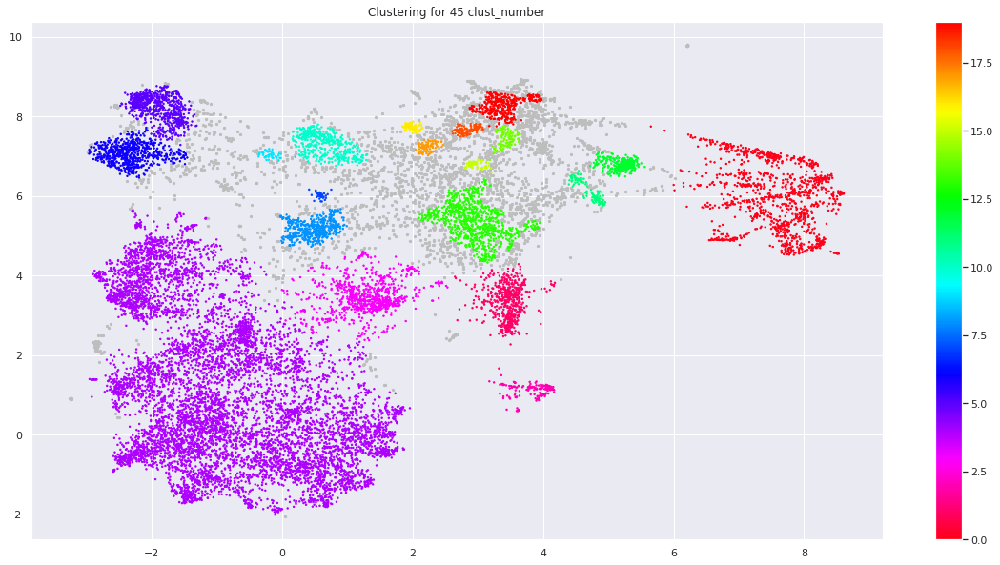

Cluster Number: 46
Homogeneity: 0.320
Completeness: 0.468
V-measure: 0.380
Adjusted Rand-Index: 0.120
Silhouette Coefficient: 0.162


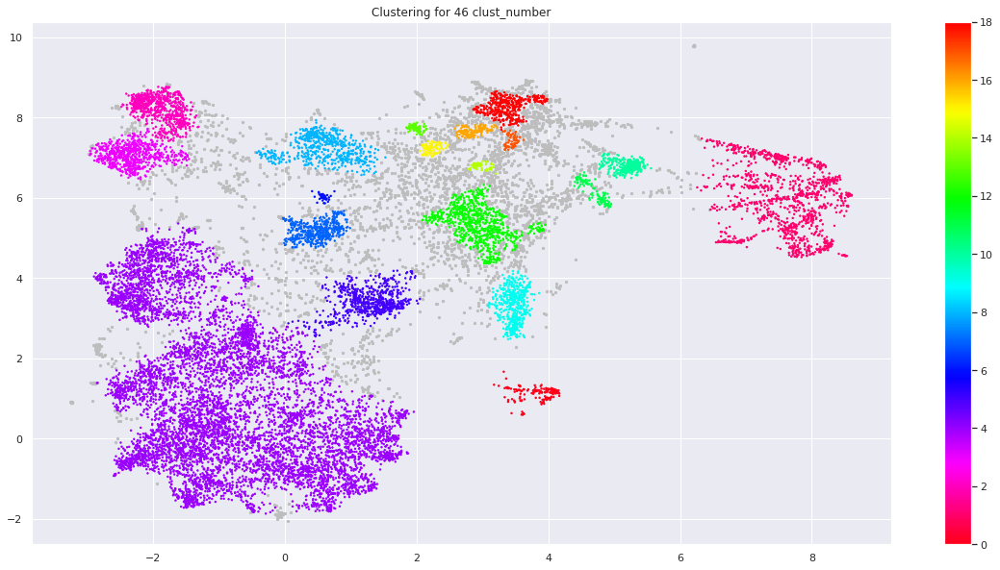

Cluster Number: 47
Homogeneity: 0.325
Completeness: 0.476
V-measure: 0.386
Adjusted Rand-Index: 0.121
Silhouette Coefficient: 0.200


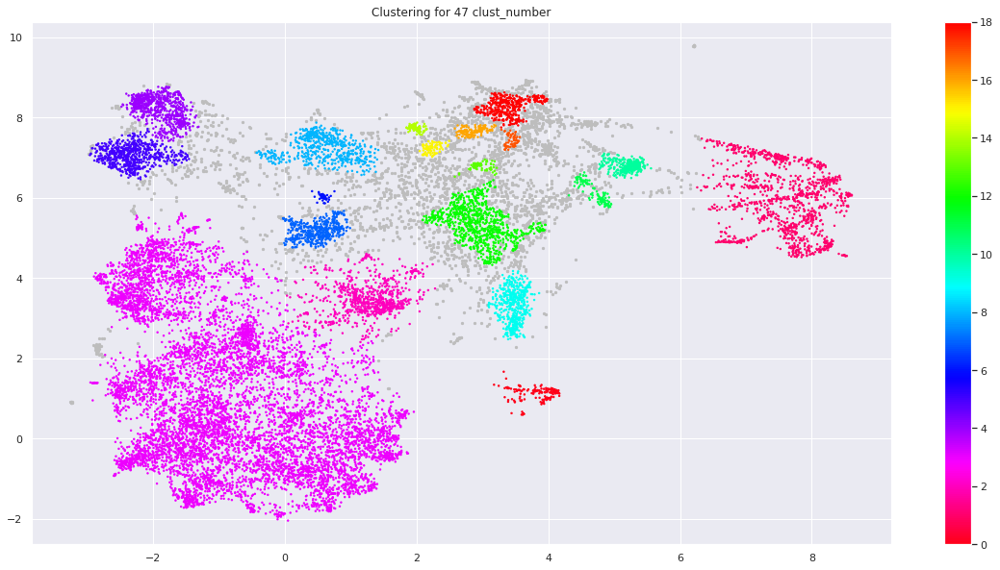

Cluster Number: 48
Homogeneity: 0.324
Completeness: 0.476
V-measure: 0.386
Adjusted Rand-Index: 0.121
Silhouette Coefficient: 0.194


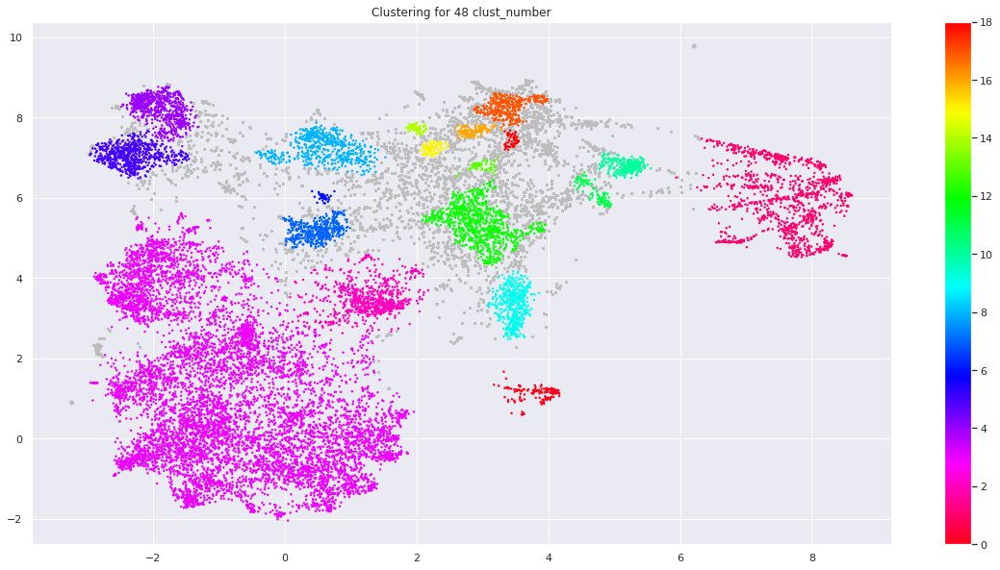

Cluster Number: 49
Homogeneity: 0.310
Completeness: 0.487
V-measure: 0.379
Adjusted Rand-Index: 0.126
Silhouette Coefficient: 0.225


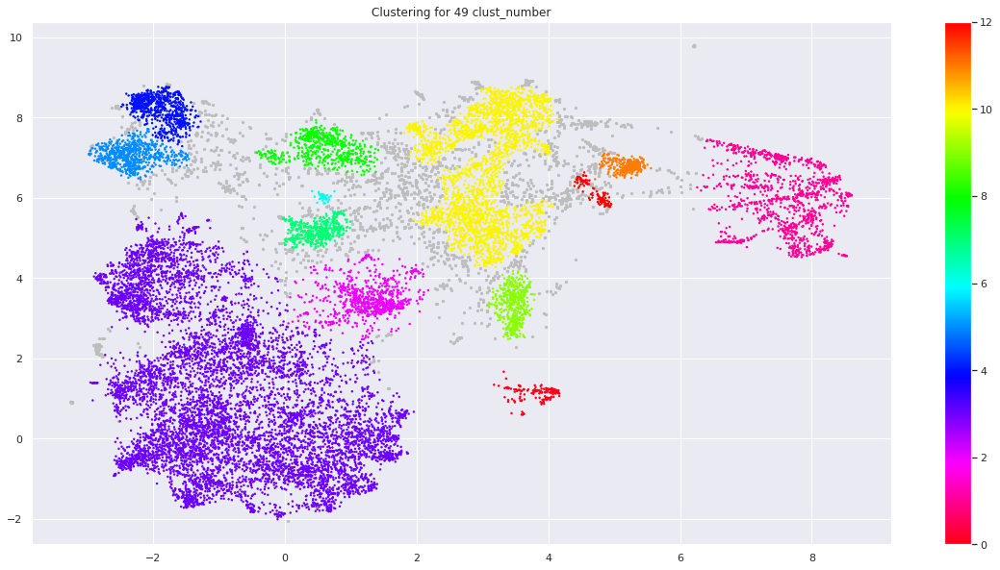

Cluster Number: 50
Homogeneity: 0.325
Completeness: 0.479
V-measure: 0.387
Adjusted Rand-Index: 0.123
Silhouette Coefficient: 0.216


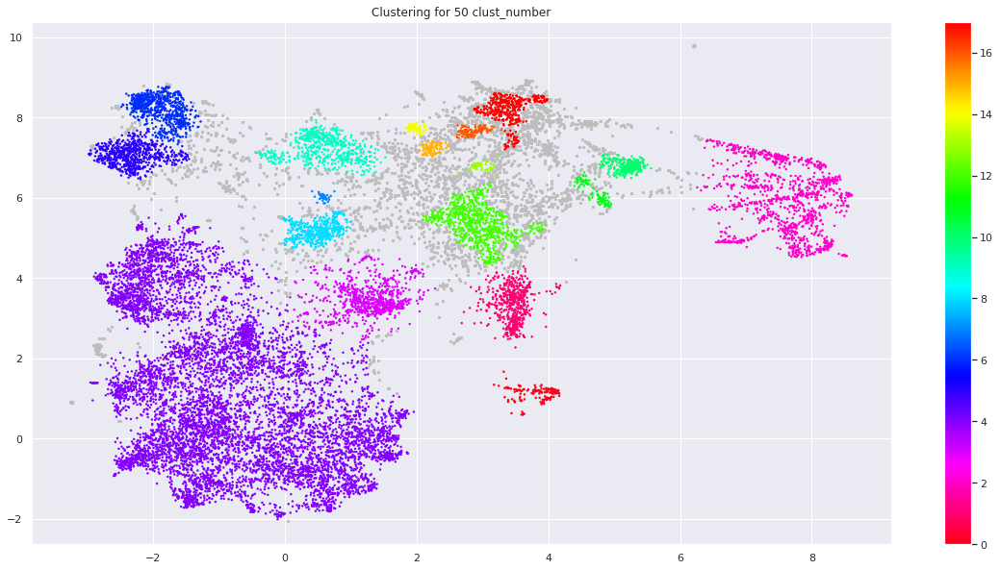

Cluster Number: 51
Homogeneity: 0.315
Completeness: 0.480
V-measure: 0.380
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.207


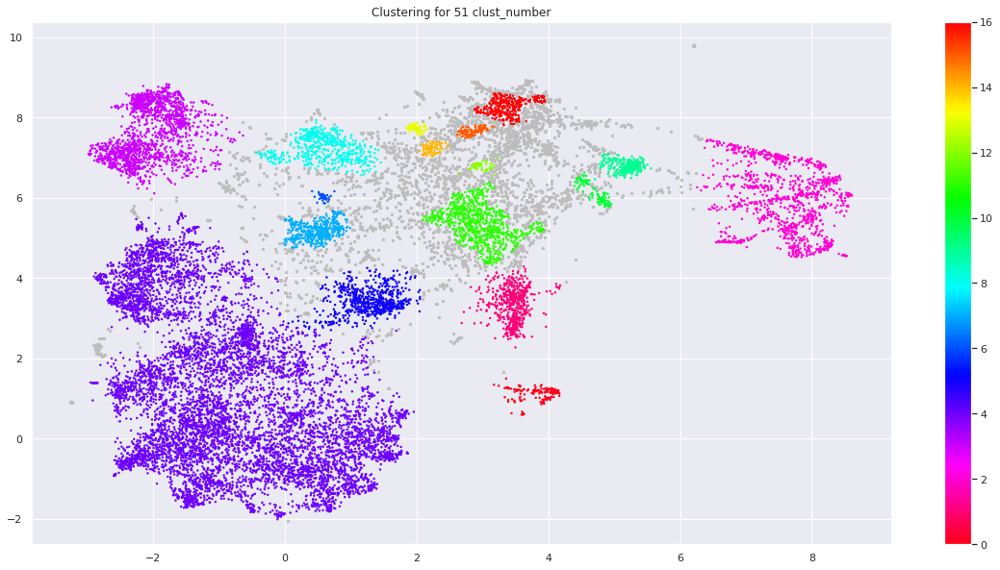

Cluster Number: 52
Homogeneity: 0.315
Completeness: 0.480
V-measure: 0.380
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.231


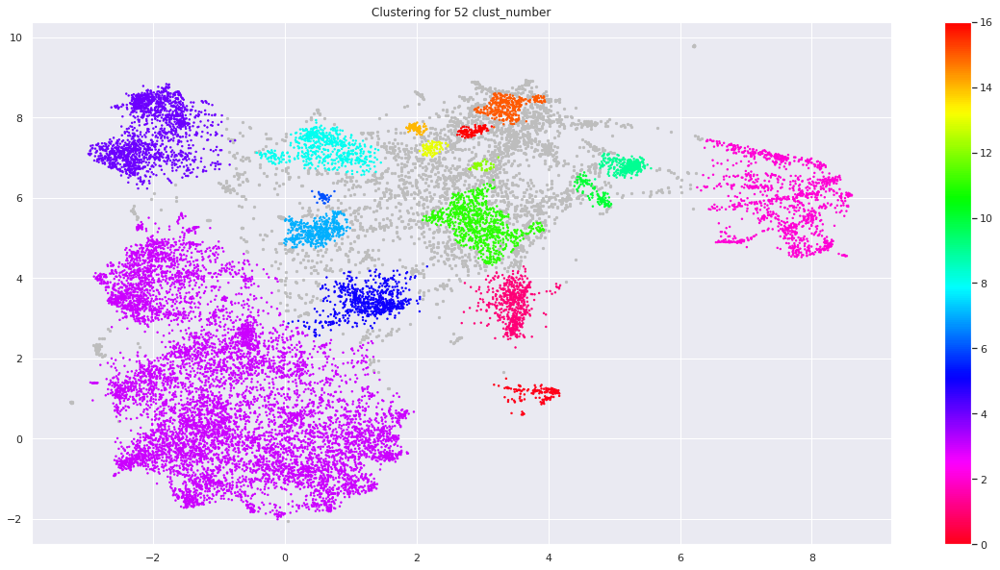

Cluster Number: 53
Homogeneity: 0.314
Completeness: 0.477
V-measure: 0.379
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.210


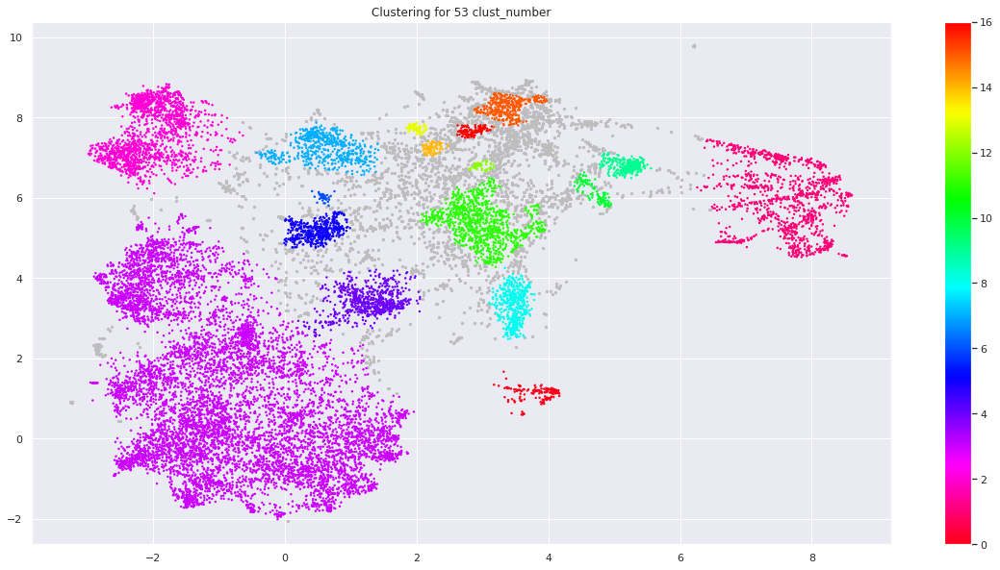

Cluster Number: 54
Homogeneity: 0.321
Completeness: 0.478
V-measure: 0.384
Adjusted Rand-Index: 0.120
Silhouette Coefficient: 0.184


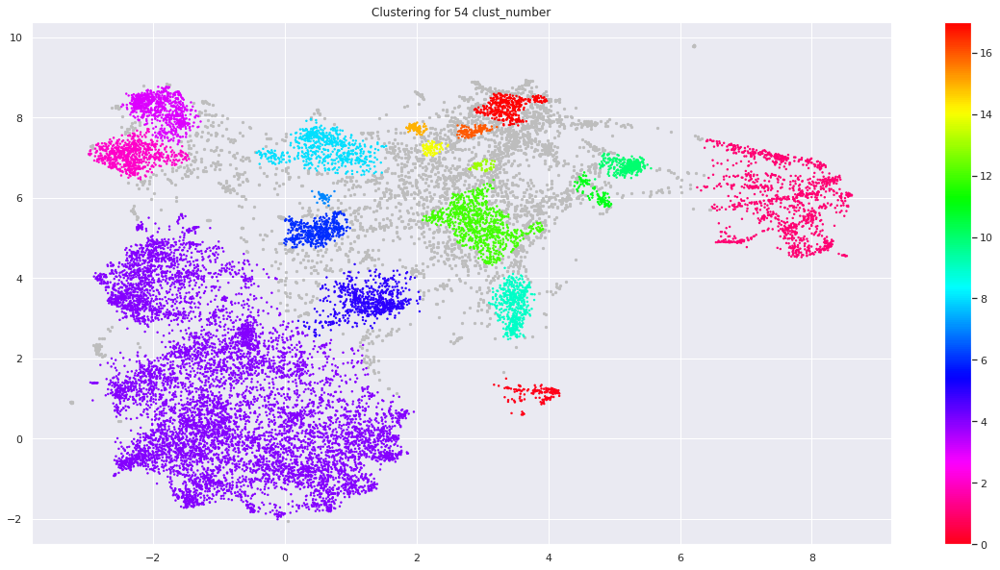

Cluster Number: 55
Homogeneity: 0.328
Completeness: 0.483
V-measure: 0.390
Adjusted Rand-Index: 0.126
Silhouette Coefficient: 0.228


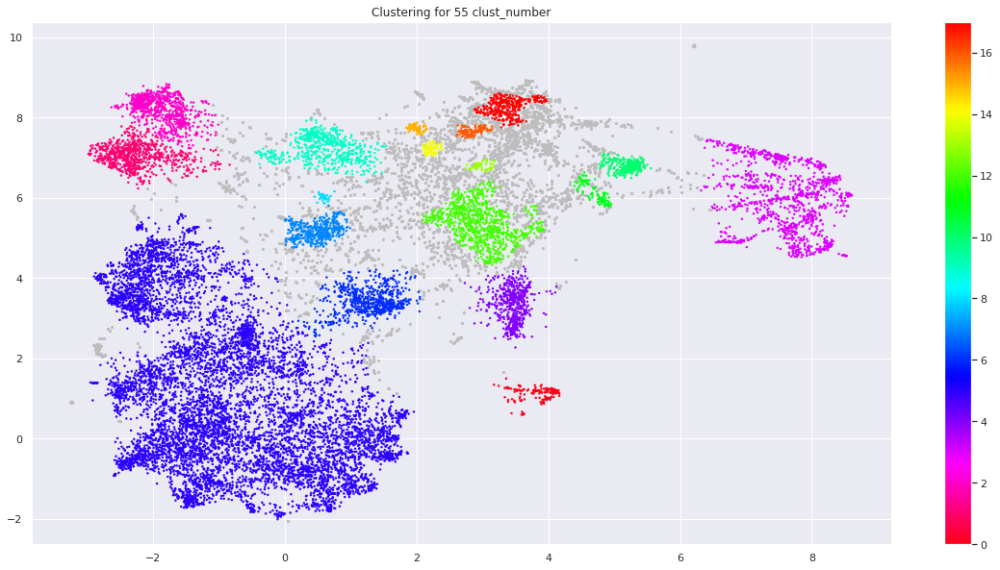

Cluster Number: 56
Homogeneity: 0.313
Completeness: 0.477
V-measure: 0.378
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.184


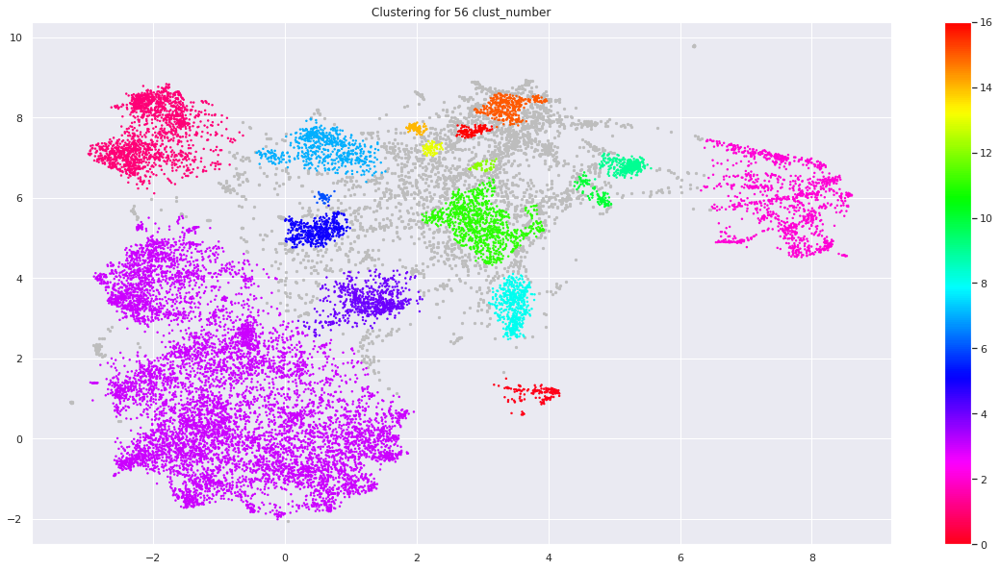

Cluster Number: 57
Homogeneity: 0.299
Completeness: 0.484
V-measure: 0.370
Adjusted Rand-Index: 0.128
Silhouette Coefficient: 0.243


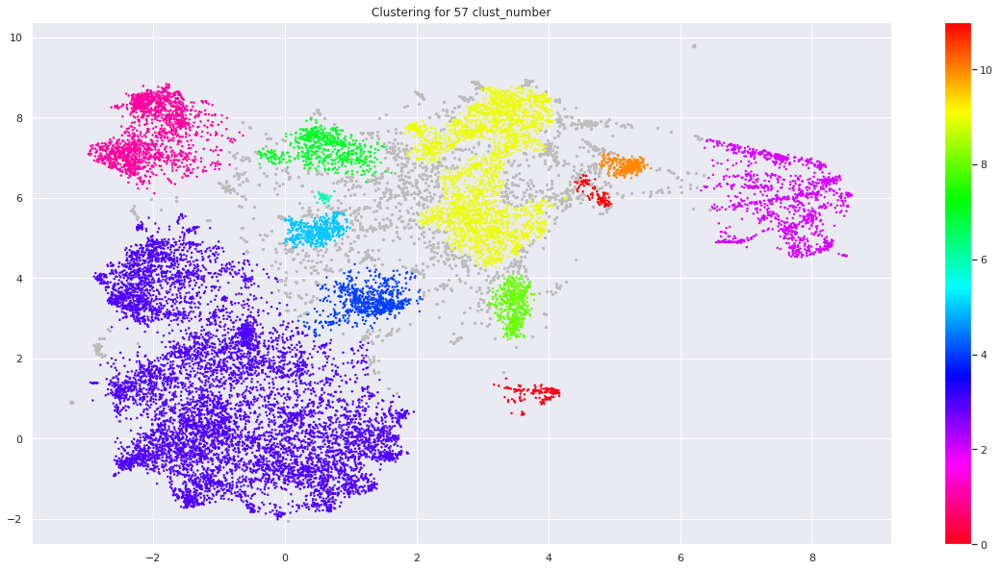

Cluster Number: 58
Homogeneity: 0.312
Completeness: 0.479
V-measure: 0.378
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.227


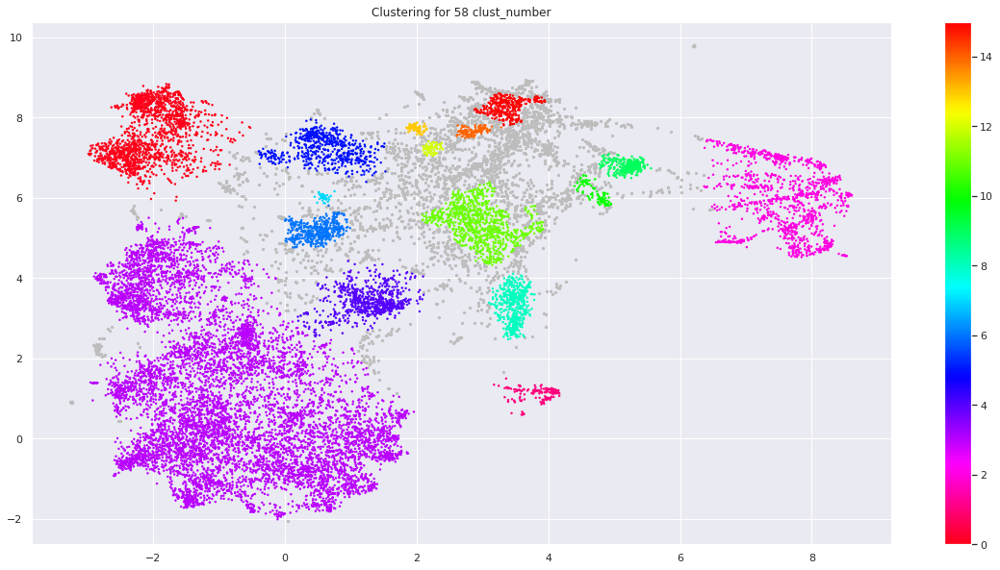

Cluster Number: 59
Homogeneity: 0.311
Completeness: 0.479
V-measure: 0.377
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.210


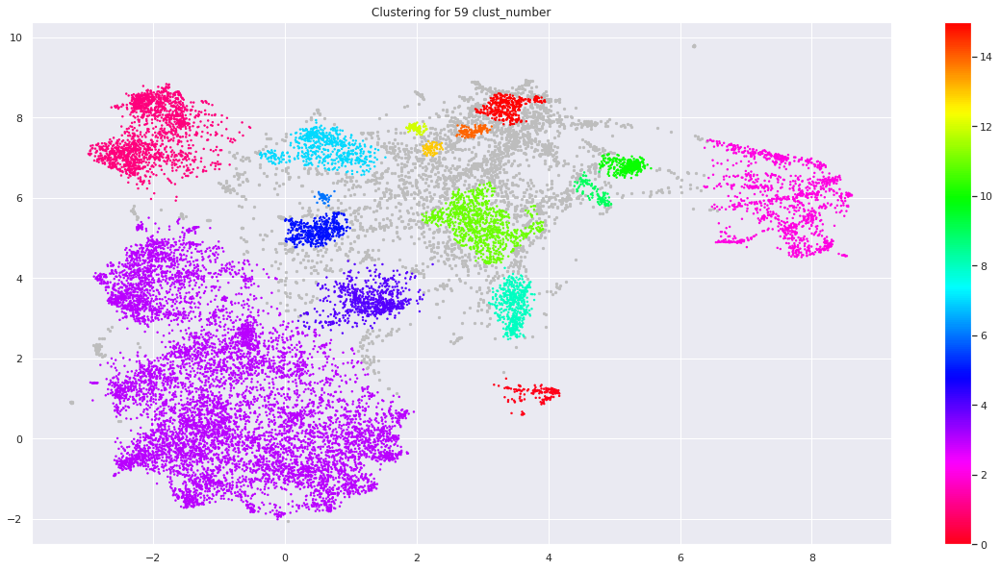

Cluster Number: 60
Homogeneity: 0.313
Completeness: 0.478
V-measure: 0.378
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.211


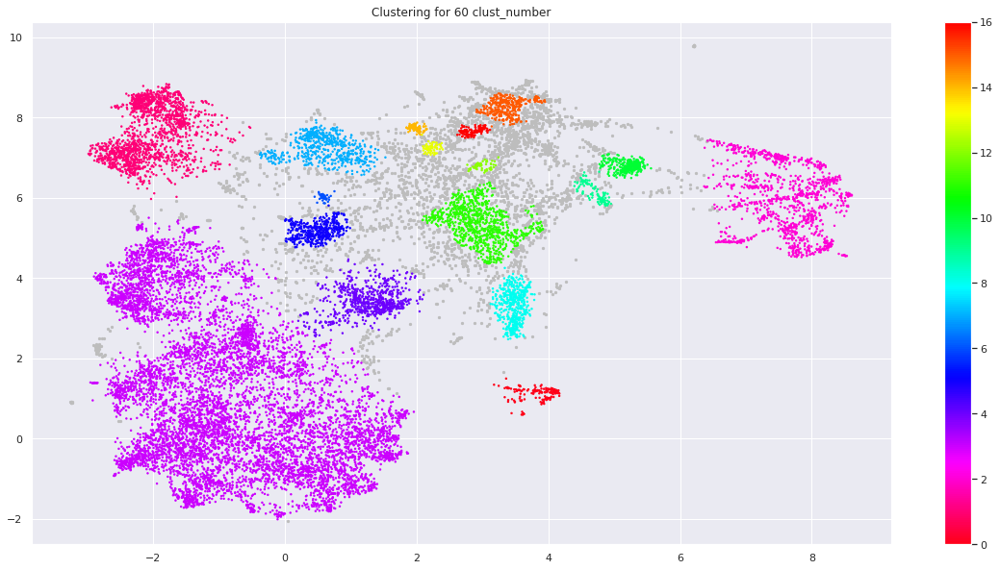

Cluster Number: 61
Homogeneity: 0.311
Completeness: 0.480
V-measure: 0.377
Adjusted Rand-Index: 0.125
Silhouette Coefficient: 0.245


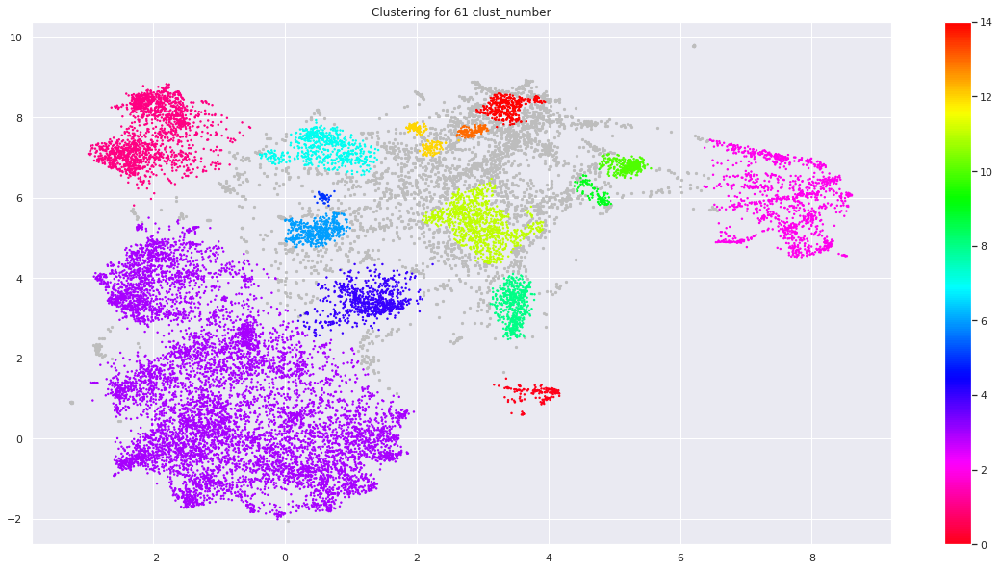

Cluster Number: 62
Homogeneity: 0.306
Completeness: 0.470
V-measure: 0.371
Adjusted Rand-Index: 0.124
Silhouette Coefficient: 0.195


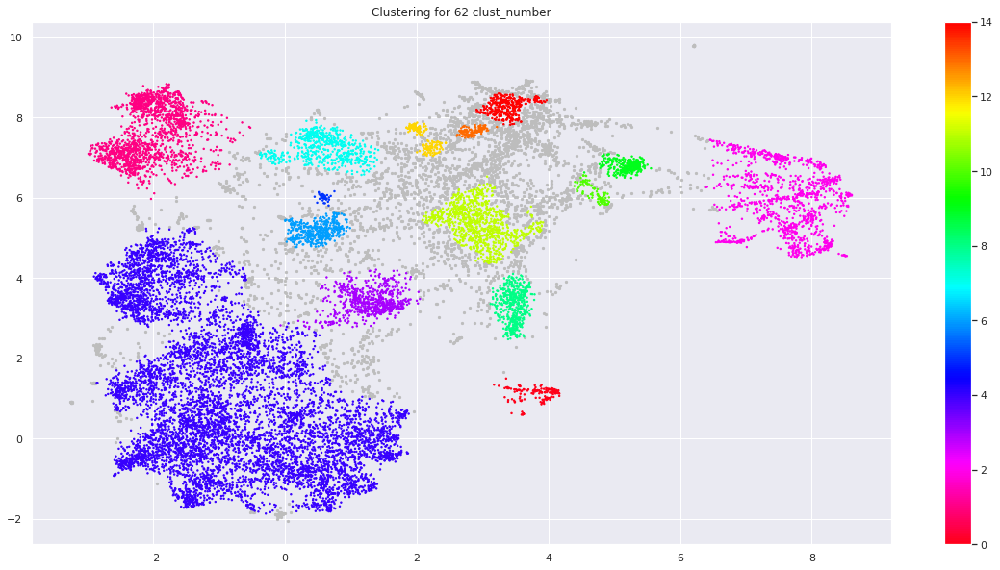

Cluster Number: 63
Homogeneity: 0.299
Completeness: 0.484
V-measure: 0.370
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.219


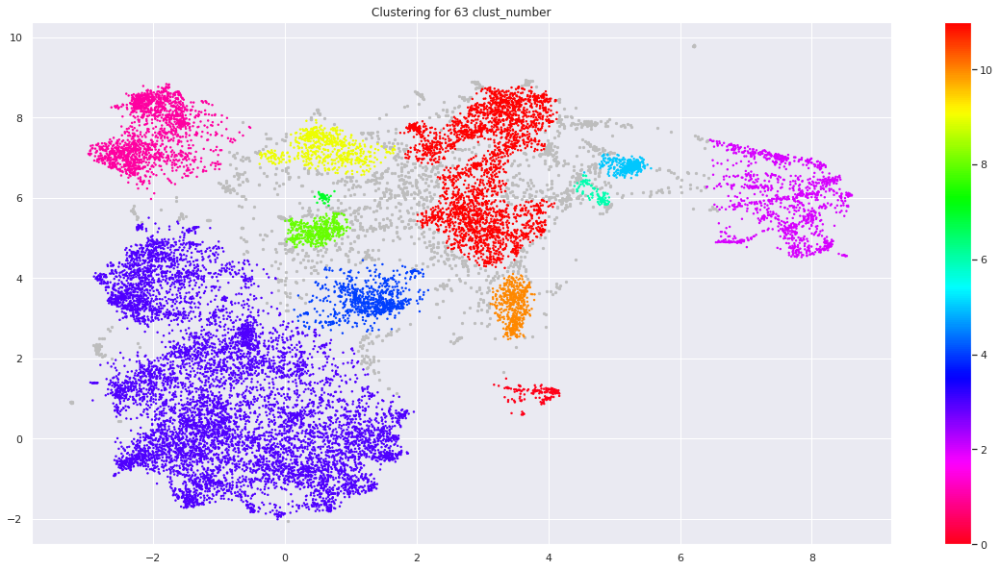

Cluster Number: 64
Homogeneity: 0.299
Completeness: 0.484
V-measure: 0.370
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.239


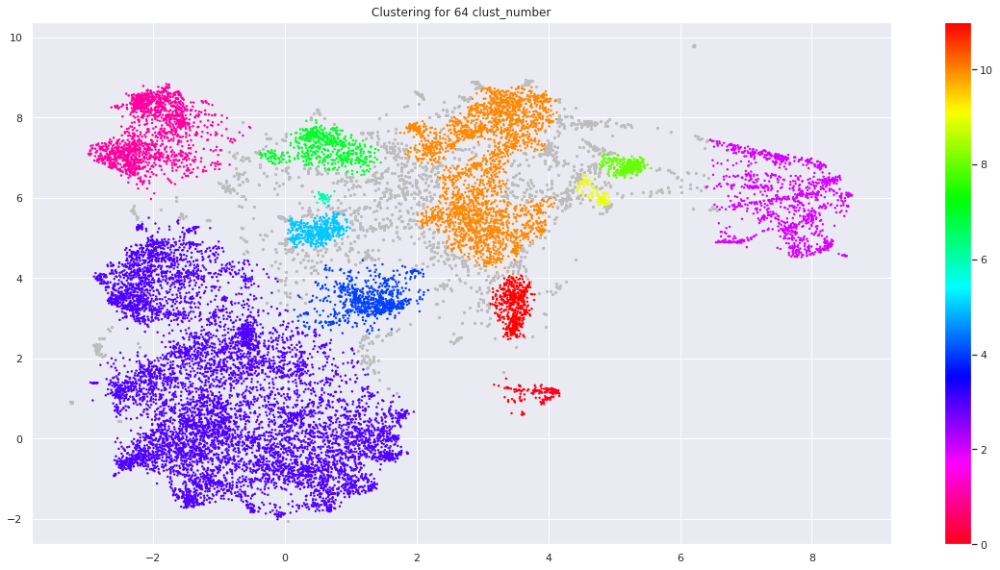

Cluster Number: 65
Homogeneity: 0.299
Completeness: 0.485
V-measure: 0.370
Adjusted Rand-Index: 0.128
Silhouette Coefficient: 0.214


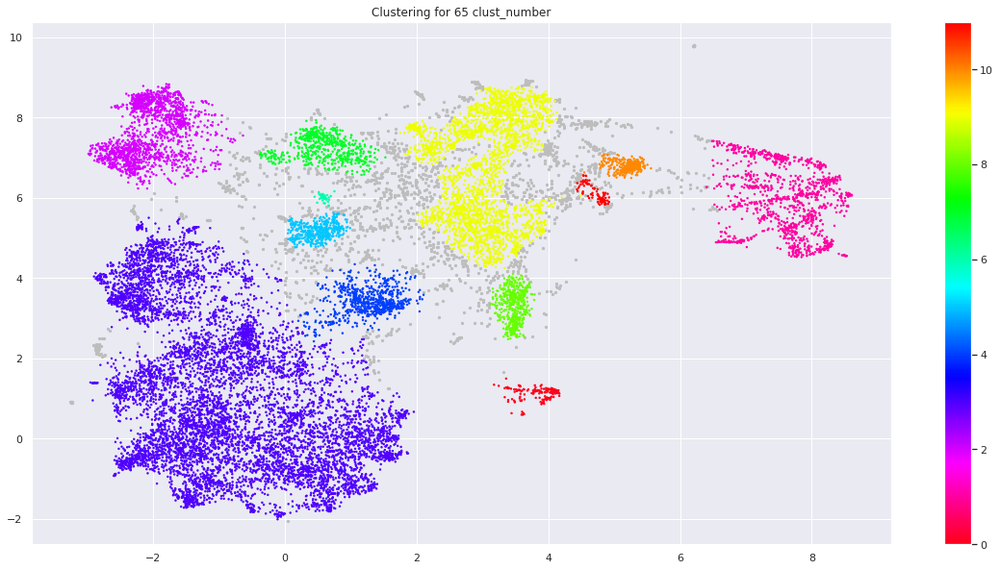

Cluster Number: 66
Homogeneity: 0.299
Completeness: 0.486
V-measure: 0.370
Adjusted Rand-Index: 0.127
Silhouette Coefficient: 0.220


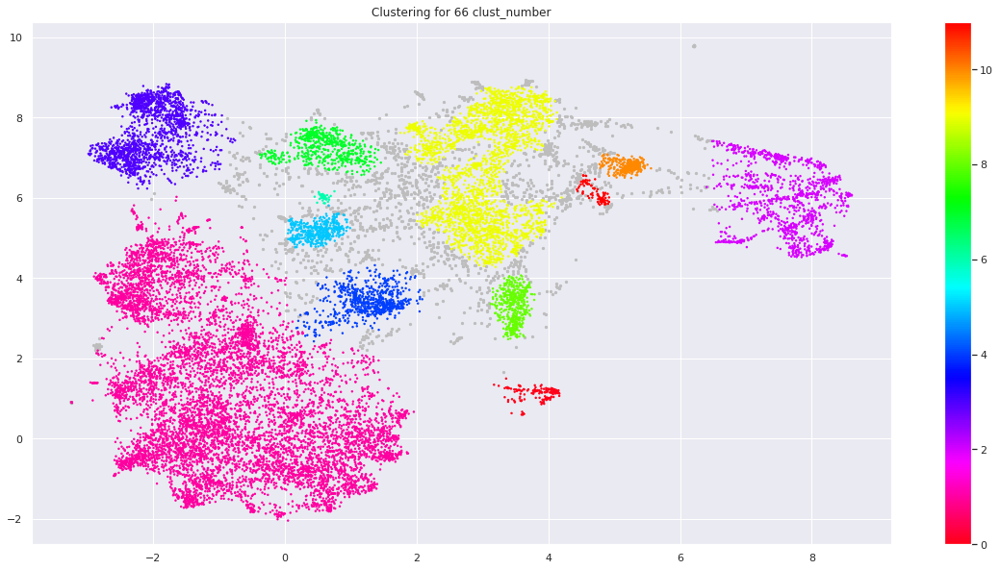

Cluster Number: 67
Homogeneity: 0.299
Completeness: 0.484
V-measure: 0.369
Adjusted Rand-Index: 0.128
Silhouette Coefficient: 0.245


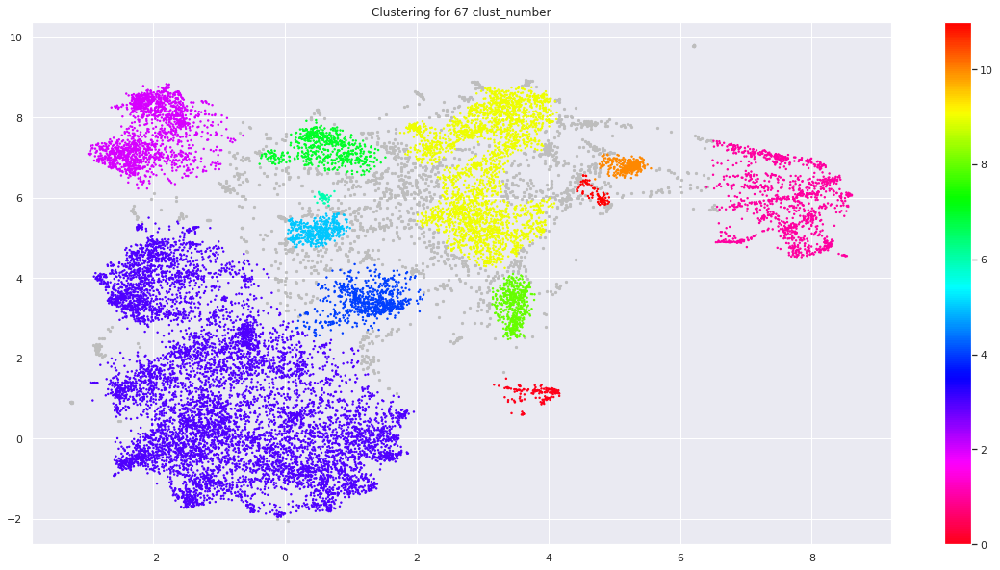

Cluster Number: 68
Homogeneity: 0.296
Completeness: 0.475
V-measure: 0.364
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.205


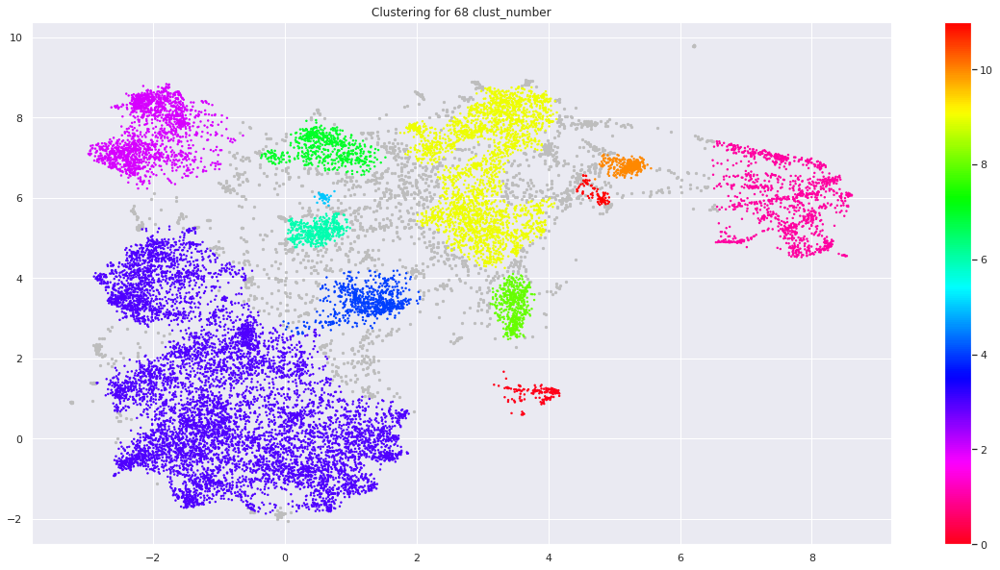

Cluster Number: 69
Homogeneity: 0.298
Completeness: 0.481
V-measure: 0.368
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.233


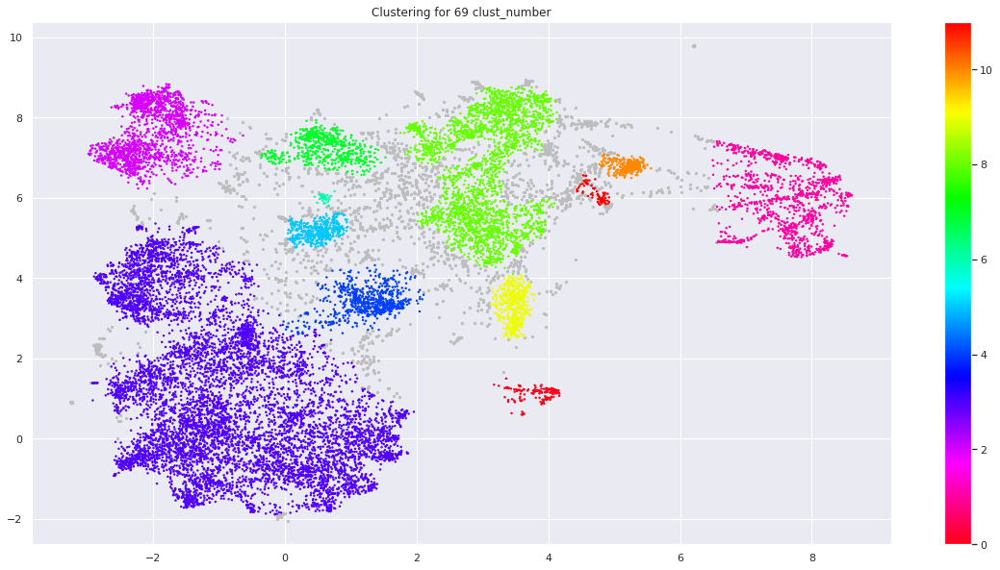

Cluster Number: 70
Homogeneity: 0.301
Completeness: 0.490
V-measure: 0.373
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.214


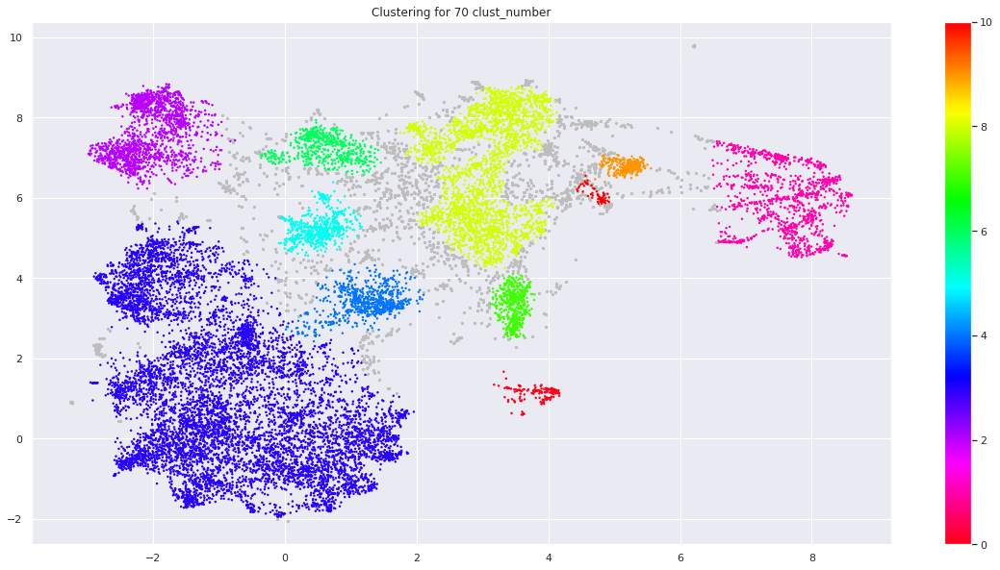

Cluster Number: 71
Homogeneity: 0.302
Completeness: 0.490
V-measure: 0.374
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.251


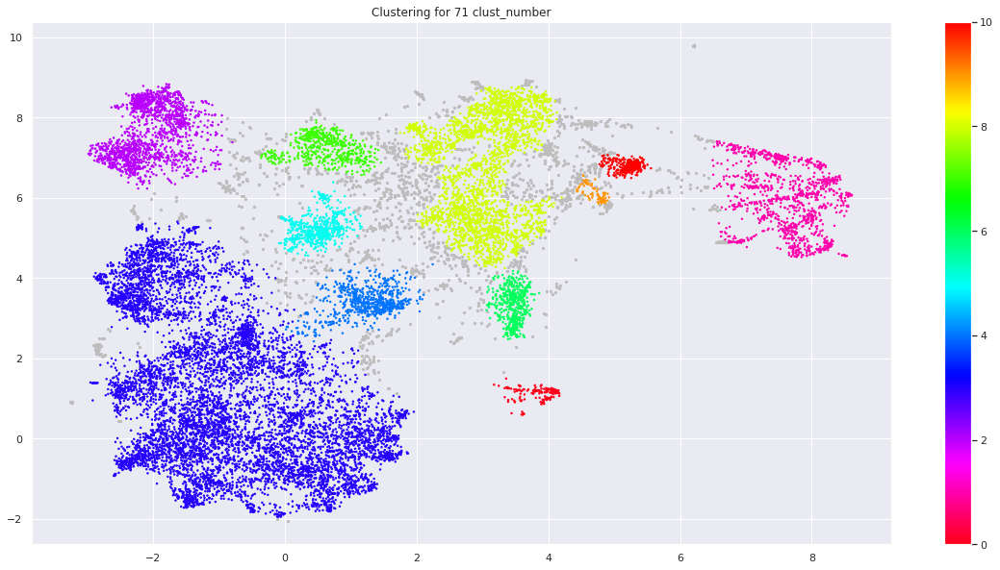

Cluster Number: 72
Homogeneity: 0.319
Completeness: 0.492
V-measure: 0.387
Adjusted Rand-Index: 0.137
Silhouette Coefficient: 0.299


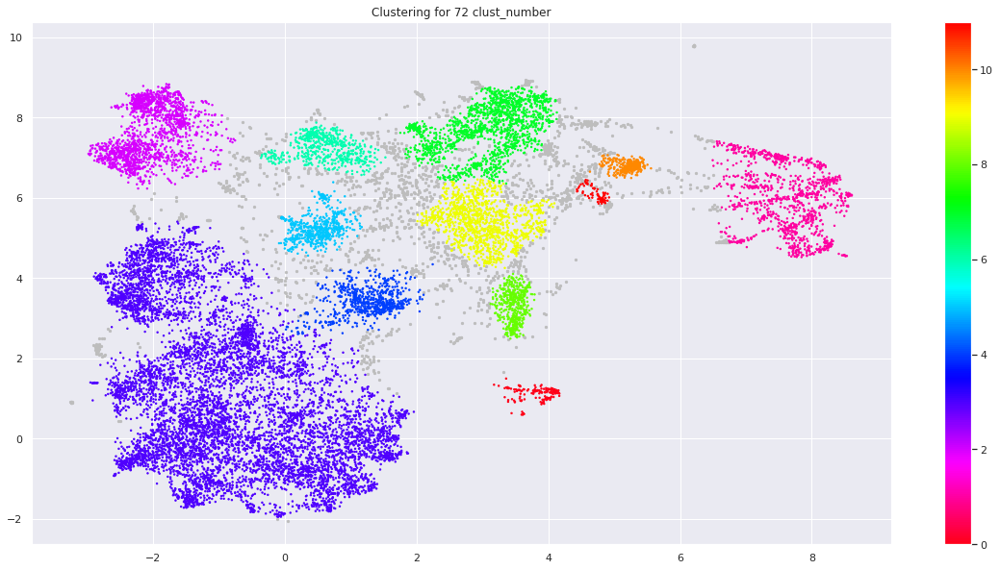

Cluster Number: 73
Homogeneity: 0.302
Completeness: 0.491
V-measure: 0.374
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.243


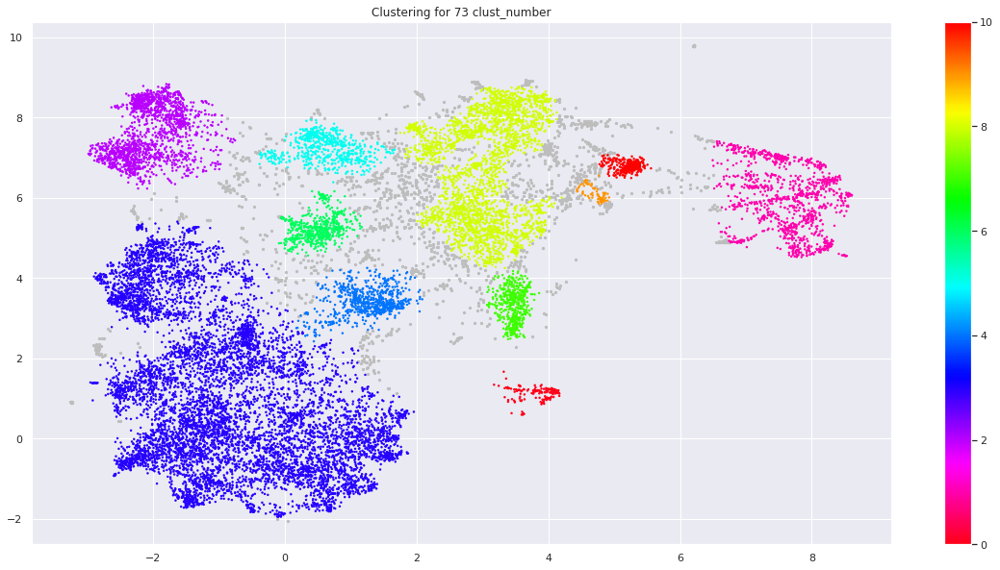

Cluster Number: 74
Homogeneity: 0.302
Completeness: 0.490
V-measure: 0.373
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.282


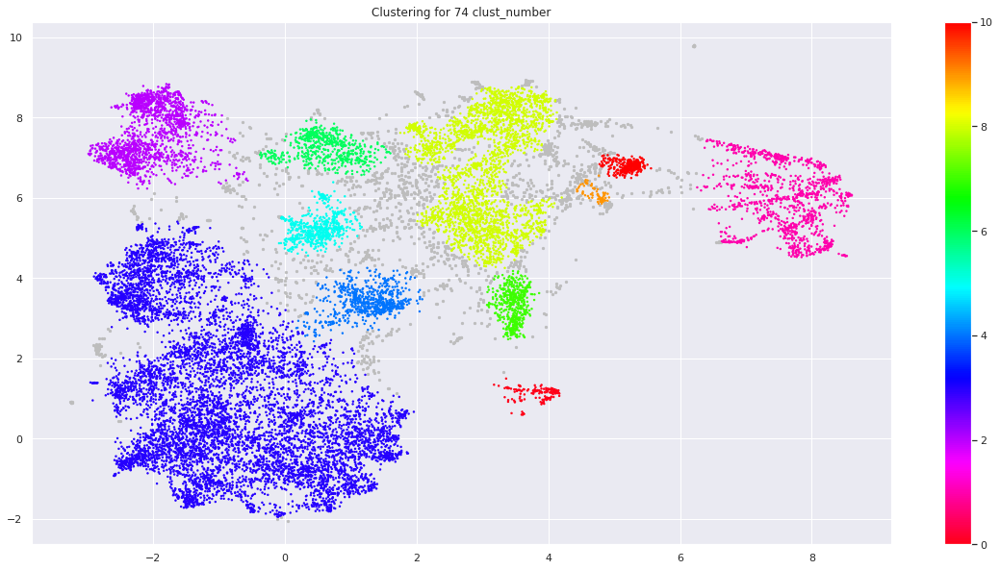

Cluster Number: 75
Homogeneity: 0.267
Completeness: 0.489
V-measure: 0.346
Adjusted Rand-Index: 0.126
Silhouette Coefficient: 0.231


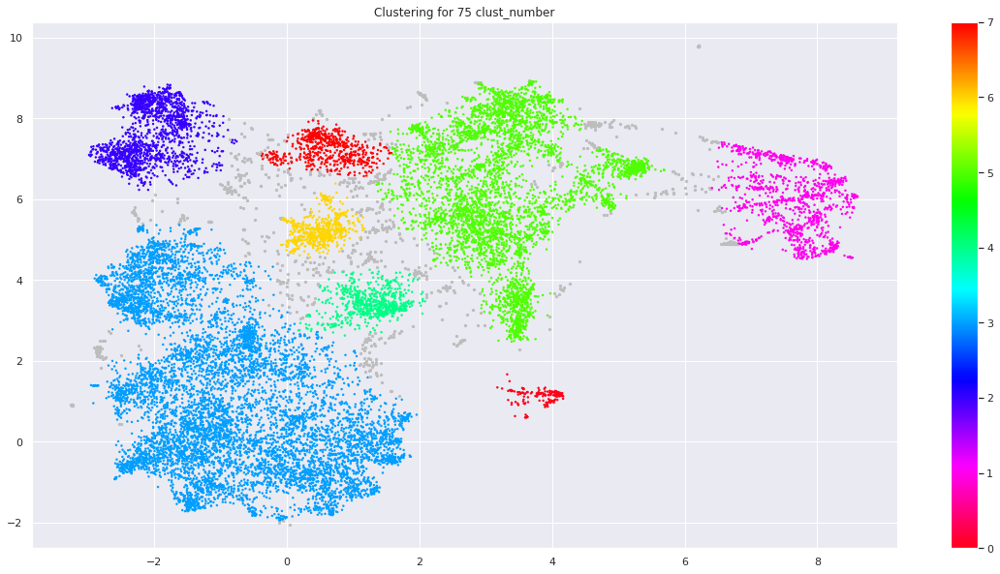

Cluster Number: 76
Homogeneity: 0.302
Completeness: 0.492
V-measure: 0.374
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.280


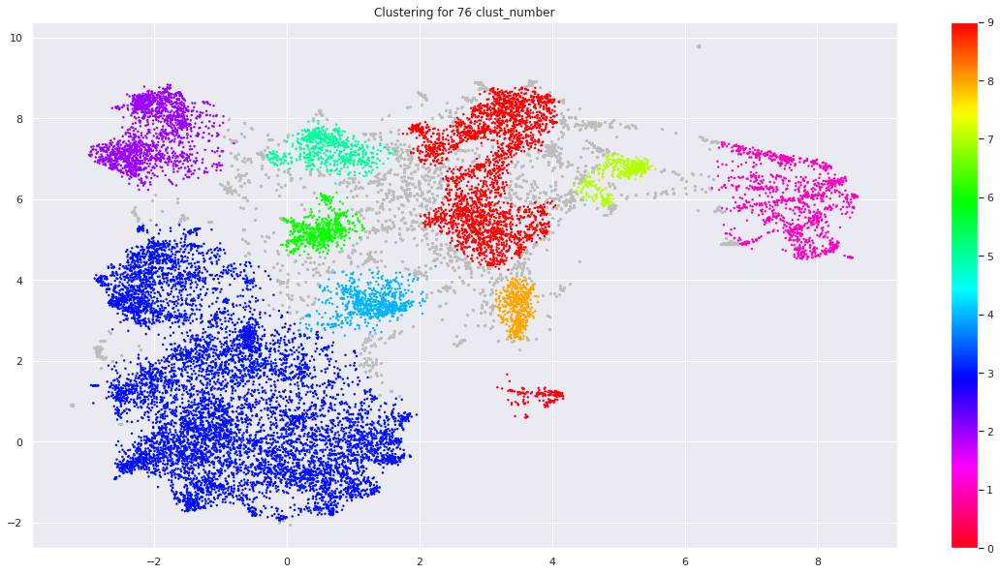

Cluster Number: 77
Homogeneity: 0.302
Completeness: 0.493
V-measure: 0.375
Adjusted Rand-Index: 0.133
Silhouette Coefficient: 0.266


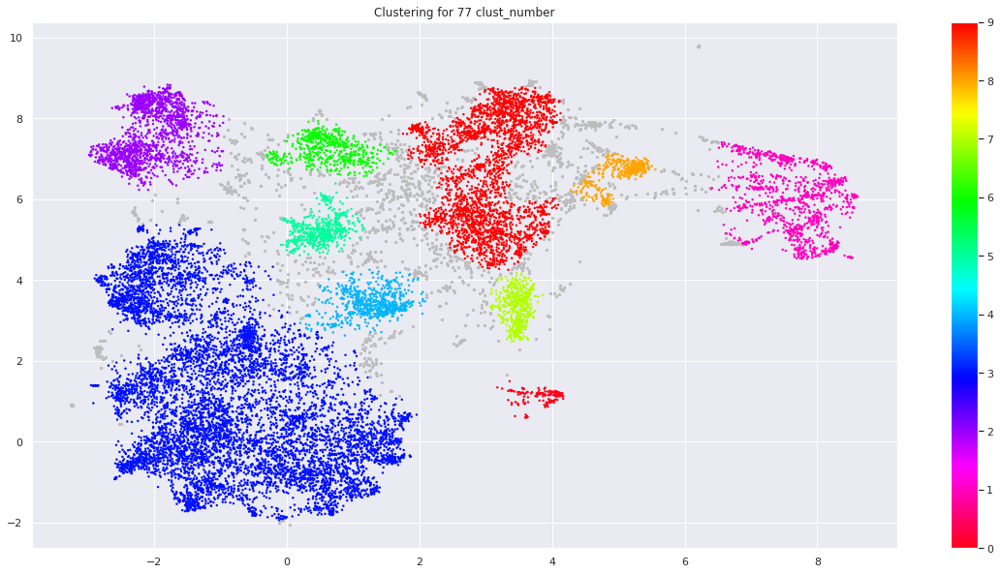

Cluster Number: 78
Homogeneity: 0.267
Completeness: 0.488
V-measure: 0.345
Adjusted Rand-Index: 0.126
Silhouette Coefficient: 0.272


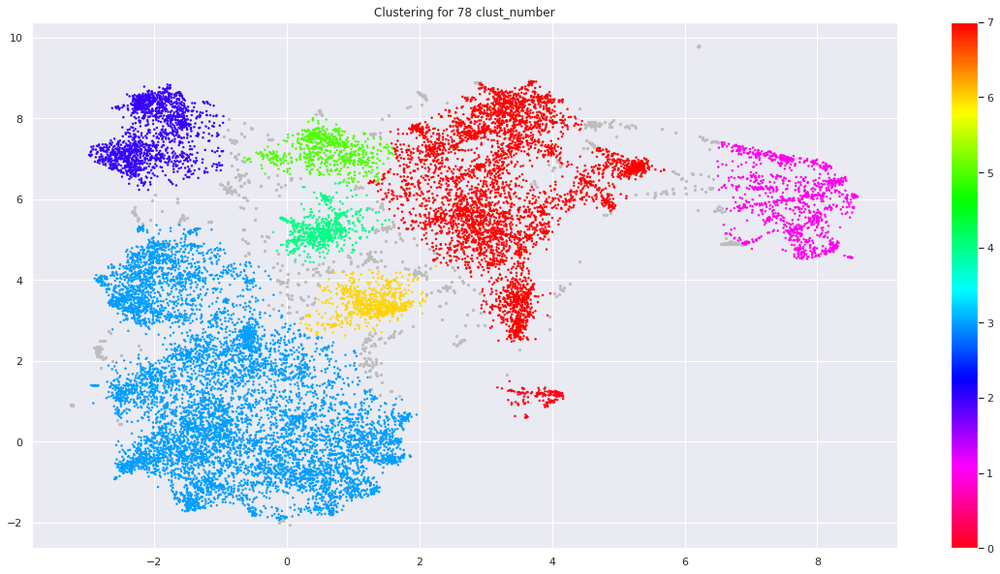

Cluster Number: 79
Homogeneity: 0.351
Completeness: 0.484
V-measure: 0.407
Adjusted Rand-Index: 0.173
Silhouette Coefficient: 0.284


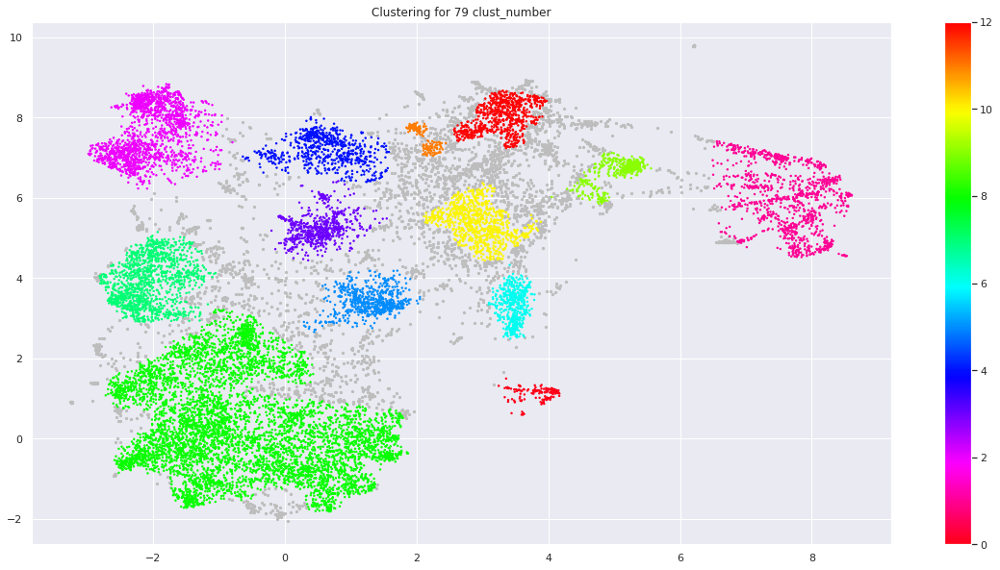

Cluster Number: 80
Homogeneity: 0.315
Completeness: 0.488
V-measure: 0.383
Adjusted Rand-Index: 0.131
Silhouette Coefficient: 0.257


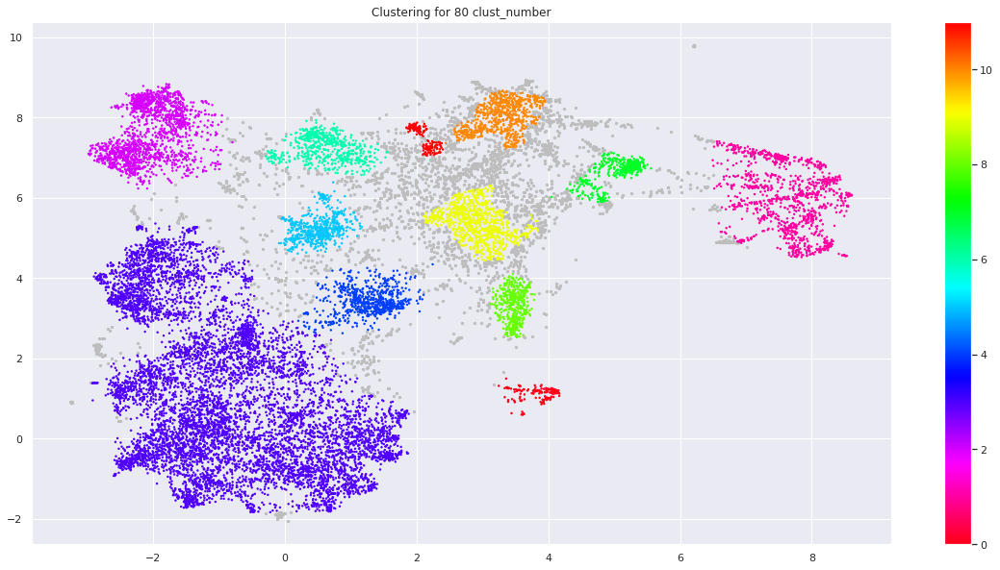

Cluster Number: 81
Homogeneity: 0.301
Completeness: 0.489
V-measure: 0.373
Adjusted Rand-Index: 0.133
Silhouette Coefficient: 0.240


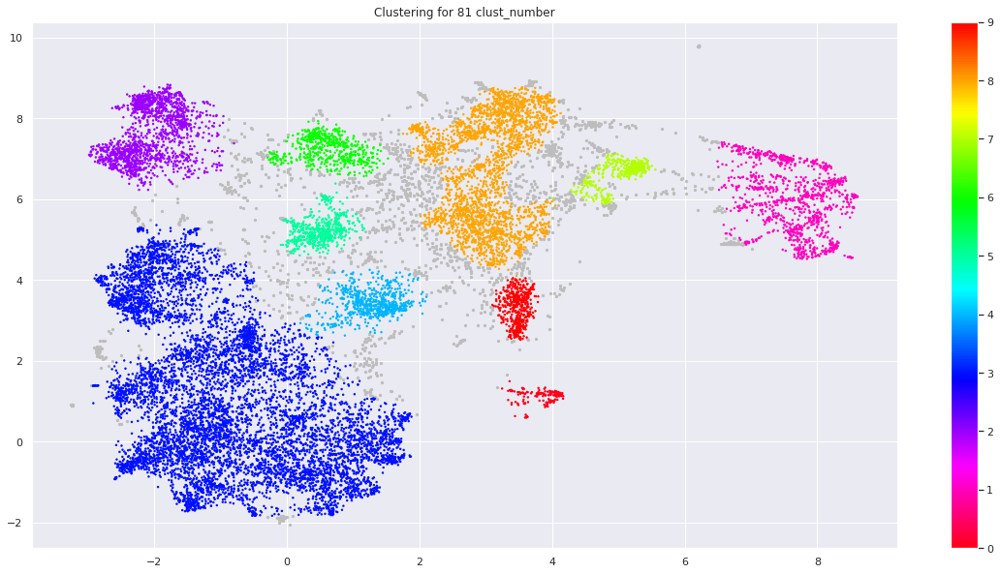

Cluster Number: 82
Homogeneity: 0.315
Completeness: 0.489
V-measure: 0.383
Adjusted Rand-Index: 0.130
Silhouette Coefficient: 0.237


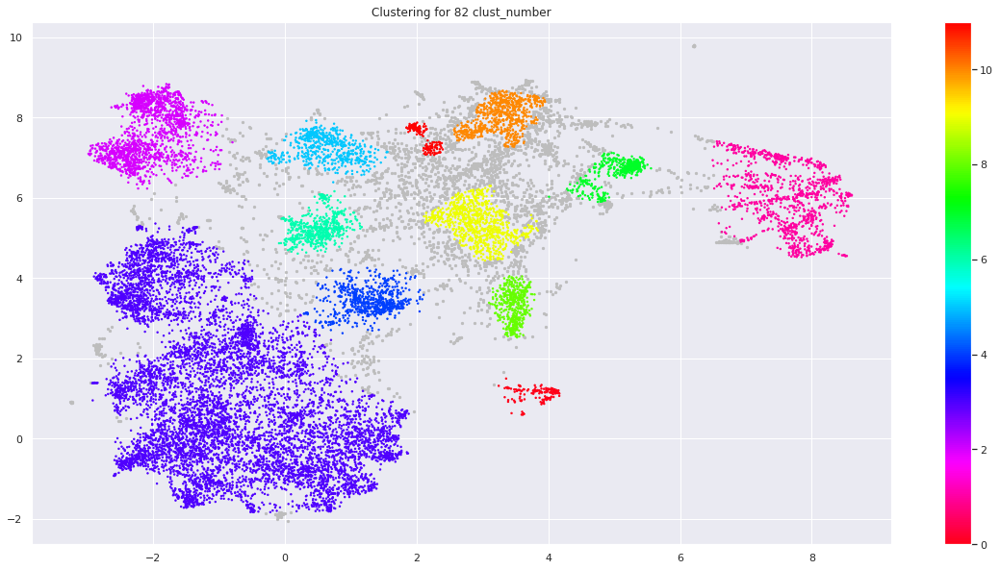

Cluster Number: 83
Homogeneity: 0.300
Completeness: 0.489
V-measure: 0.372
Adjusted Rand-Index: 0.133
Silhouette Coefficient: 0.242


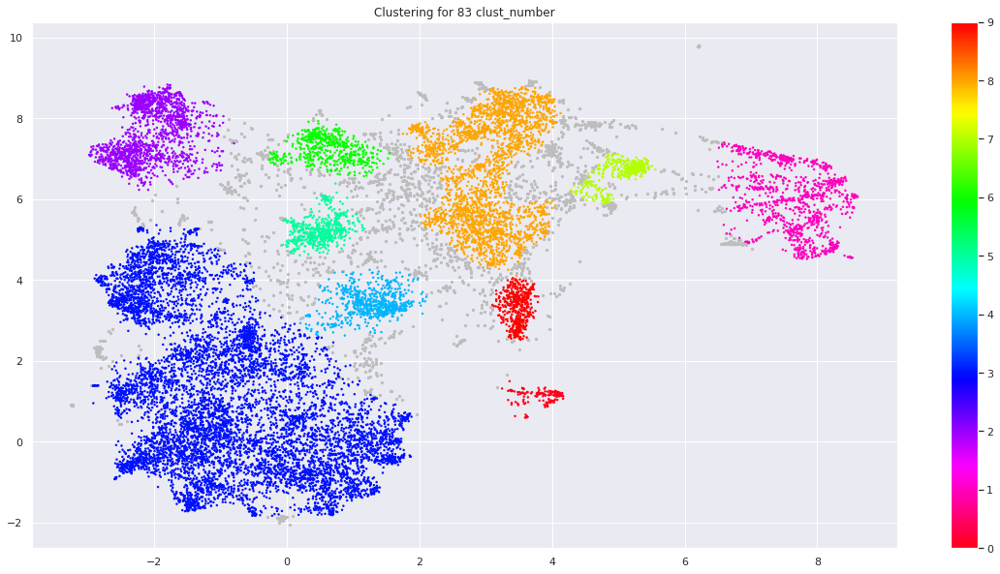

Cluster Number: 84
Homogeneity: 0.313
Completeness: 0.487
V-measure: 0.381
Adjusted Rand-Index: 0.129
Silhouette Coefficient: 0.258


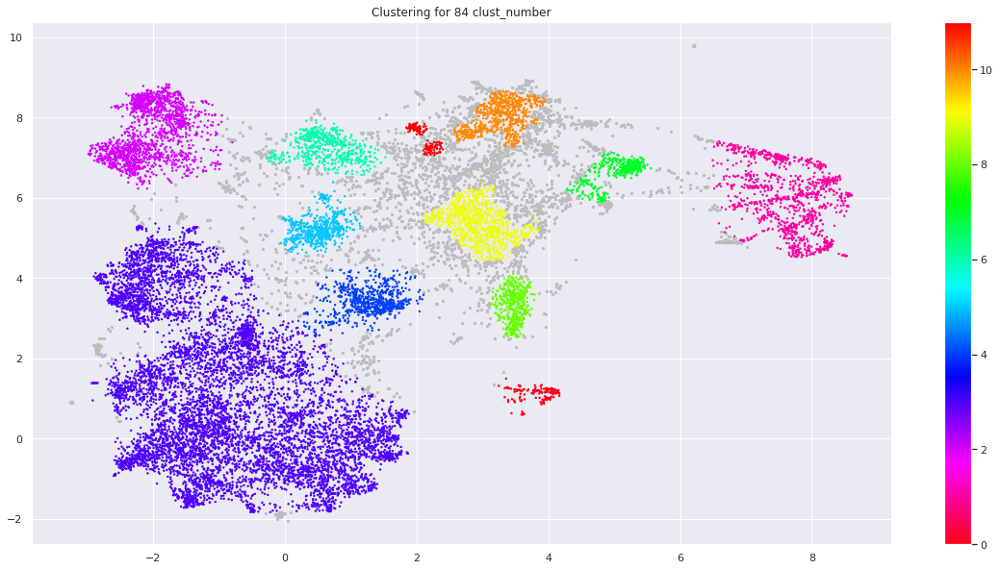

Cluster Number: 85
Homogeneity: 0.300
Completeness: 0.490
V-measure: 0.372
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.268


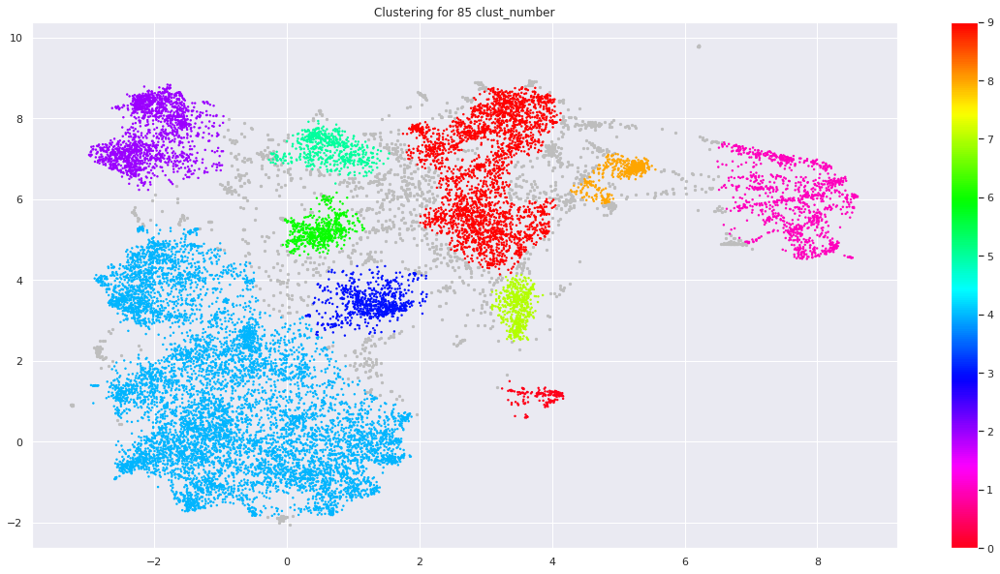

Cluster Number: 86
Homogeneity: 0.300
Completeness: 0.489
V-measure: 0.371
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.250


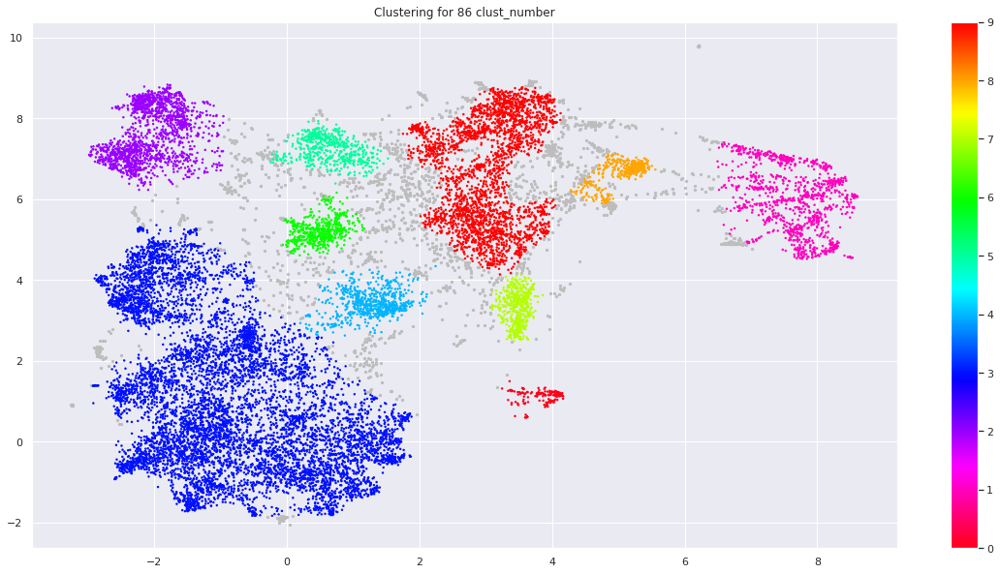

Cluster Number: 87
Homogeneity: 0.299
Completeness: 0.488
V-measure: 0.371
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.258


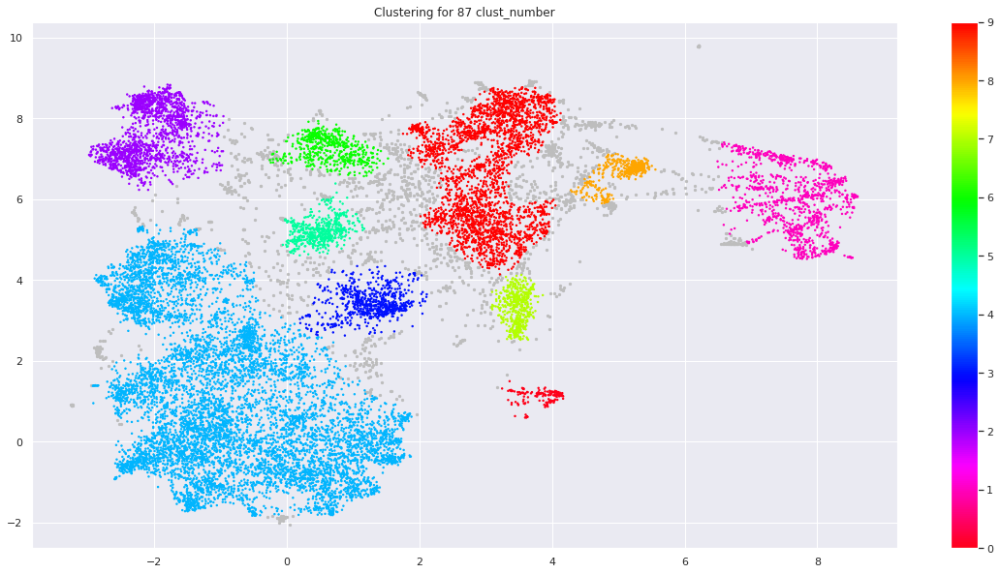

Cluster Number: 88
Homogeneity: 0.299
Completeness: 0.488
V-measure: 0.371
Adjusted Rand-Index: 0.132
Silhouette Coefficient: 0.257


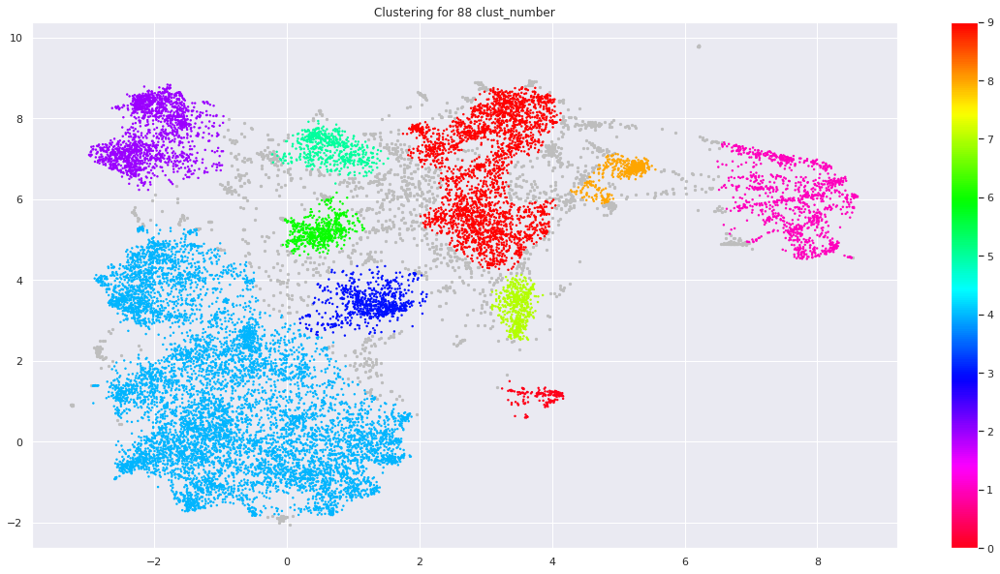

Cluster Number: 89
Homogeneity: 0.298
Completeness: 0.488
V-measure: 0.370
Adjusted Rand-Index: 0.131
Silhouette Coefficient: 0.242


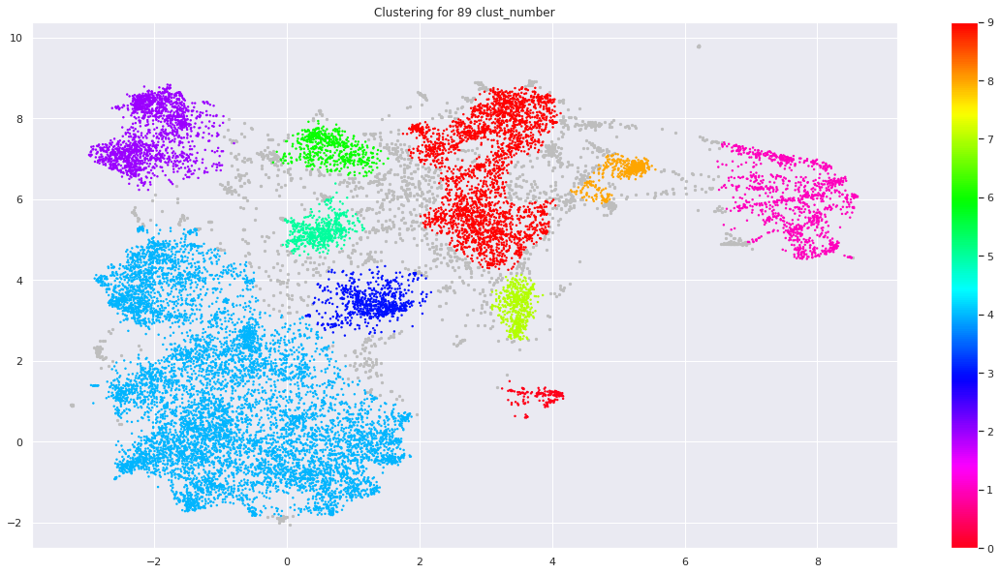

Cluster Number: 90
Homogeneity: 0.298
Completeness: 0.487
V-measure: 0.370
Adjusted Rand-Index: 0.131
Silhouette Coefficient: 0.249


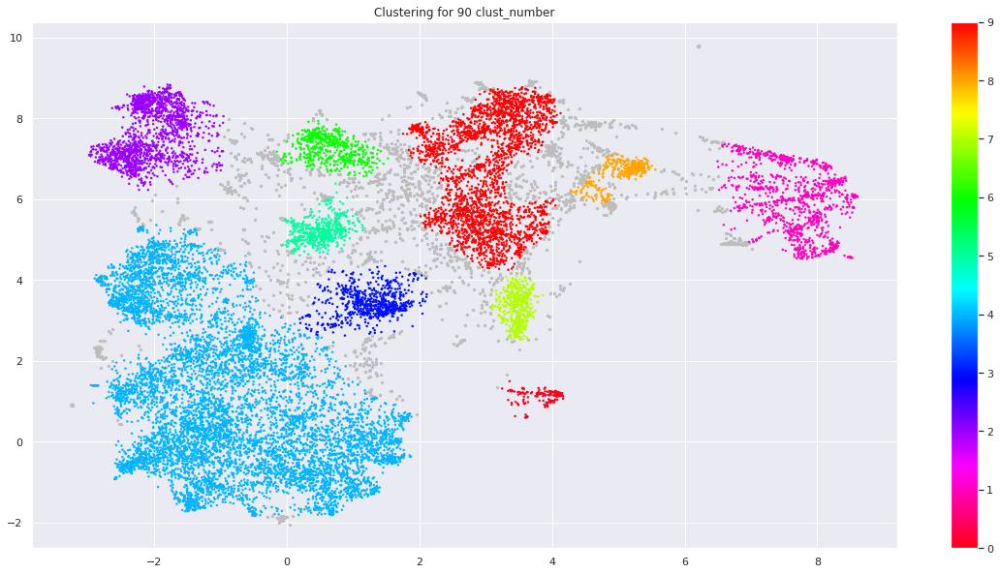

Cluster Number: 91
Homogeneity: 0.335
Completeness: 0.486
V-measure: 0.397
Adjusted Rand-Index: 0.172
Silhouette Coefficient: 0.297


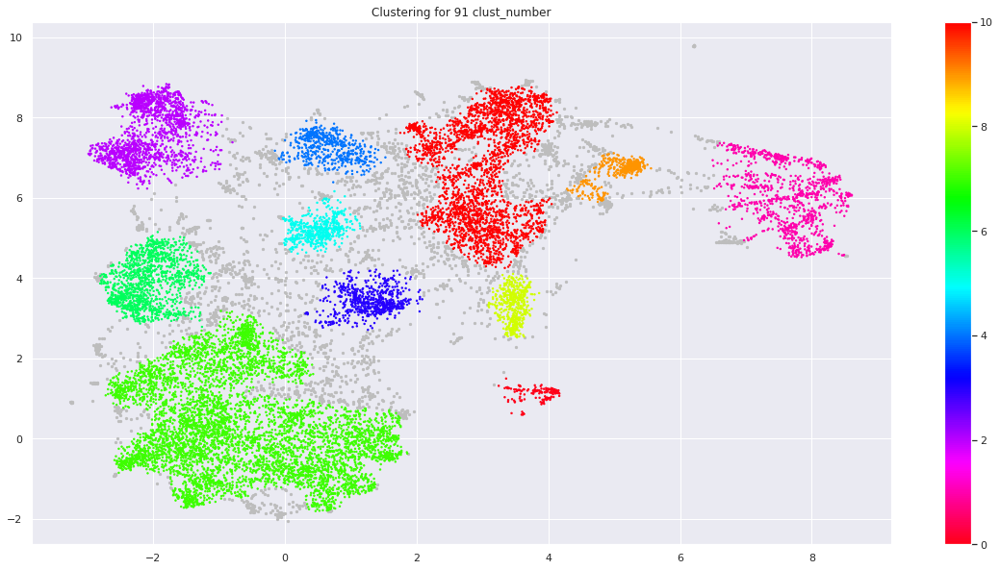

Cluster Number: 92
Homogeneity: 0.334
Completeness: 0.485
V-measure: 0.396
Adjusted Rand-Index: 0.171
Silhouette Coefficient: 0.287


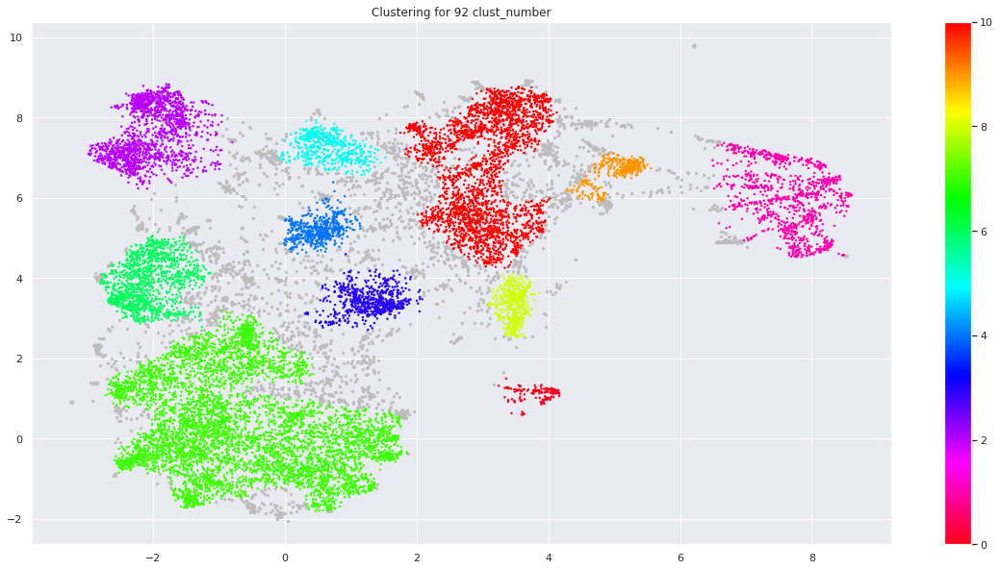

Cluster Number: 93
Homogeneity: 0.334
Completeness: 0.485
V-measure: 0.396
Adjusted Rand-Index: 0.172
Silhouette Coefficient: 0.285


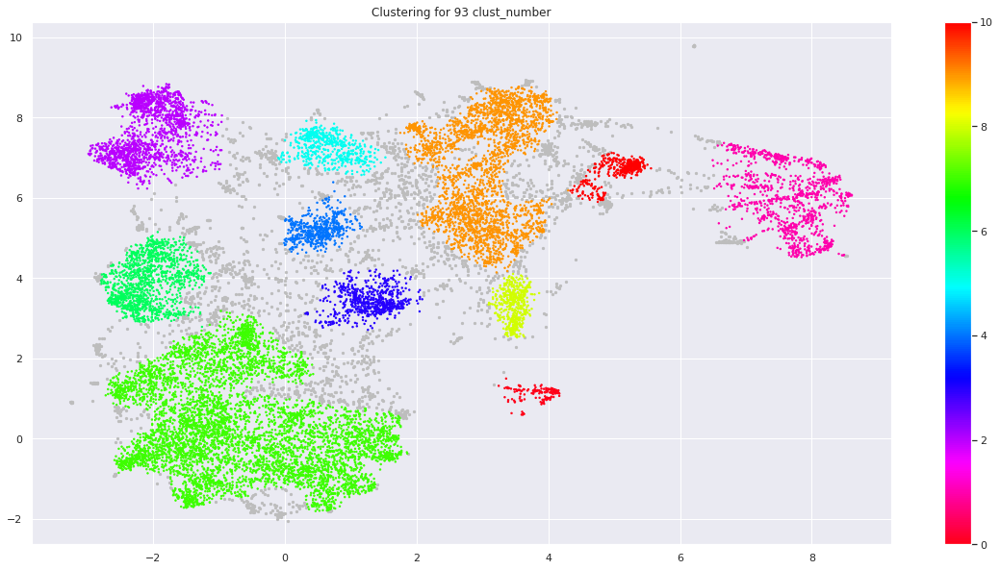

Cluster Number: 94
Homogeneity: 0.334
Completeness: 0.484
V-measure: 0.395
Adjusted Rand-Index: 0.171
Silhouette Coefficient: 0.301


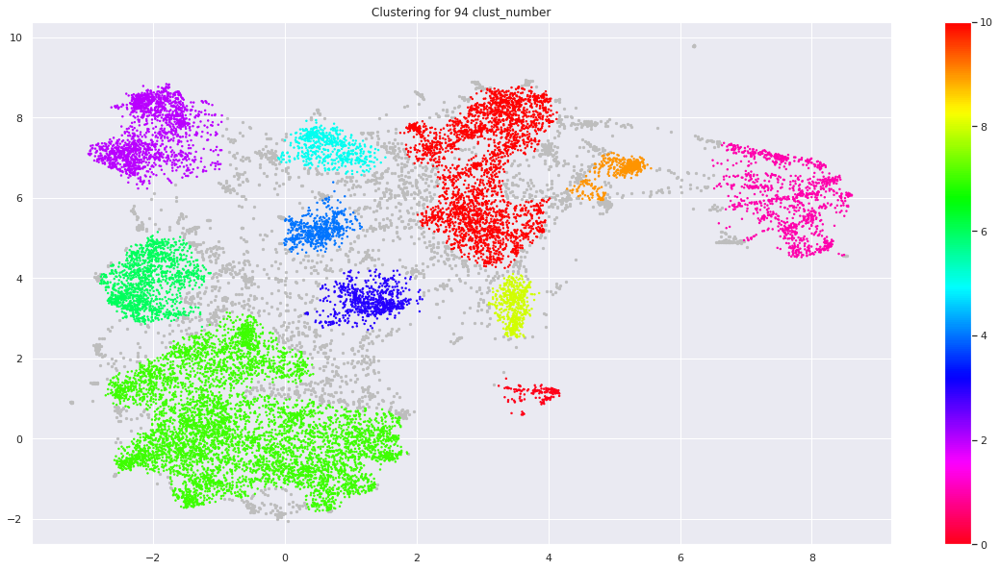

Cluster Number: 95
Homogeneity: 0.334
Completeness: 0.486
V-measure: 0.396
Adjusted Rand-Index: 0.170
Silhouette Coefficient: 0.288


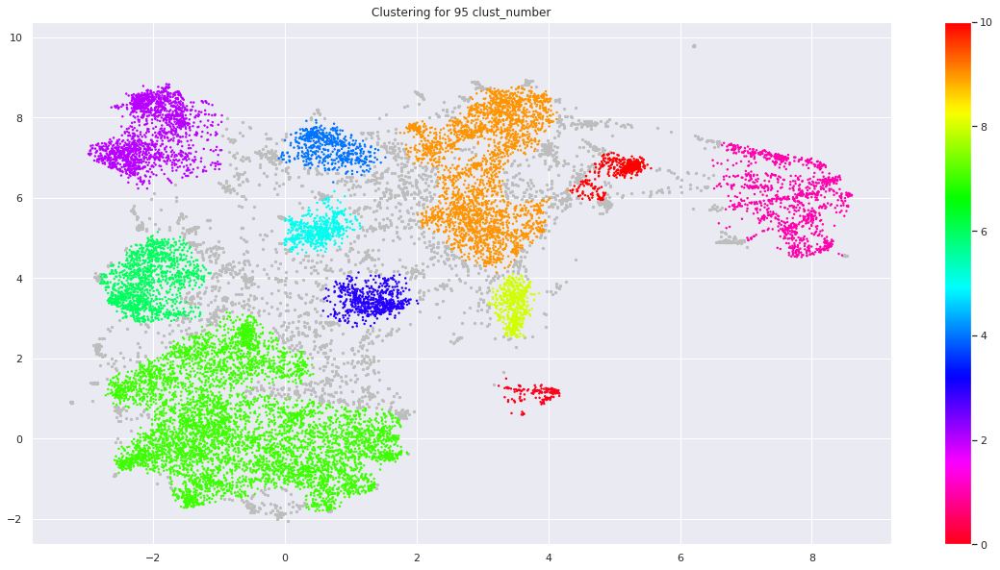

Cluster Number: 96
Homogeneity: 0.334
Completeness: 0.485
V-measure: 0.395
Adjusted Rand-Index: 0.170
Silhouette Coefficient: 0.284


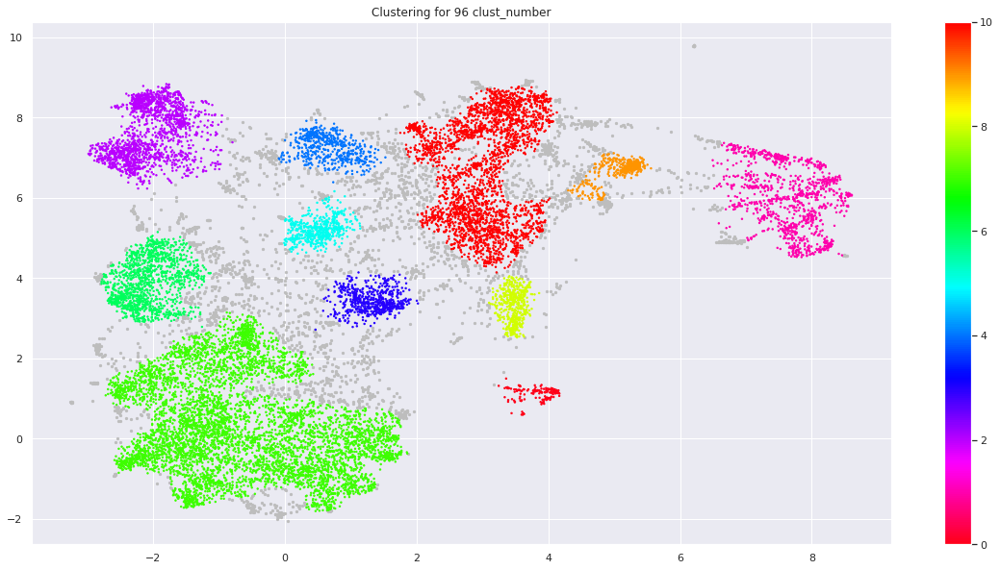

Cluster Number: 97
Homogeneity: 0.333
Completeness: 0.485
V-measure: 0.395
Adjusted Rand-Index: 0.170
Silhouette Coefficient: 0.268


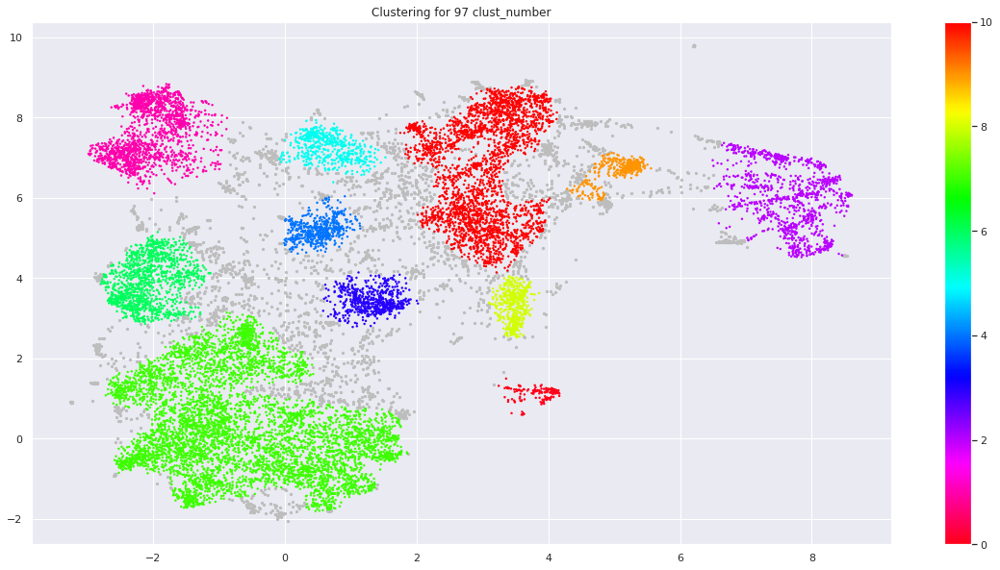

Cluster Number: 98
Homogeneity: 0.360
Completeness: 0.449
V-measure: 0.400
Adjusted Rand-Index: 0.172
Silhouette Coefficient: 0.201


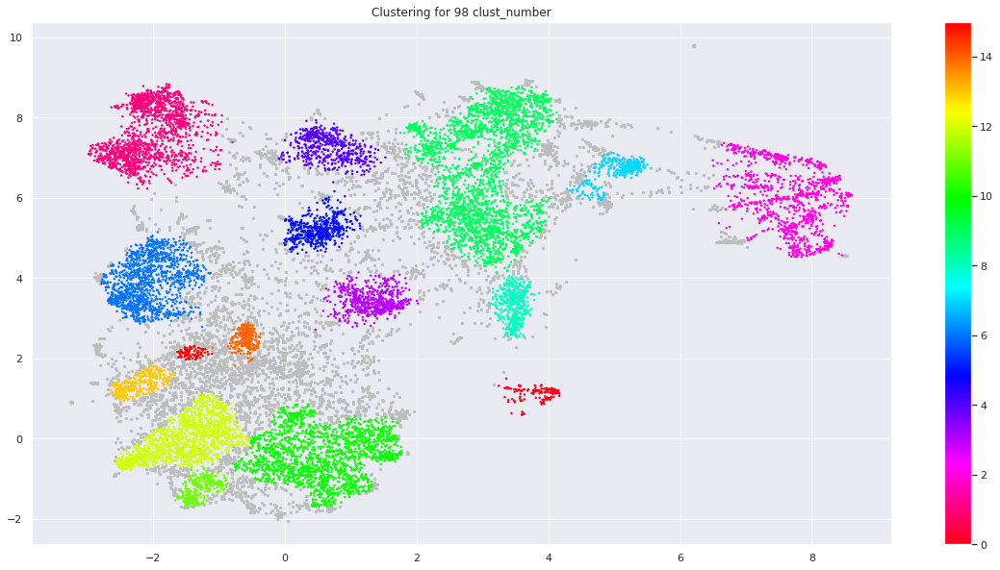

Cluster Number: 99
Homogeneity: 0.366
Completeness: 0.446
V-measure: 0.402
Adjusted Rand-Index: 0.151
Silhouette Coefficient: 0.154


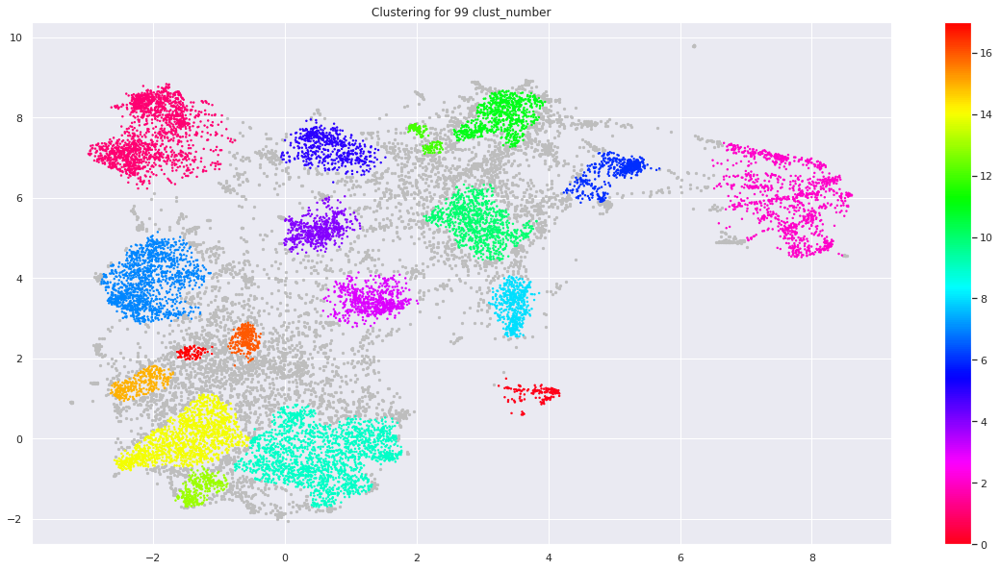

<Figure size 432x288 with 0 Axes>

In [ ]:
import hdbscan 


clust_number = 2
plot_number = 1

while clust_number < 100:
    print("Cluster Number:", clust_number)
    hdb = hdbscan.HDBSCAN(min_cluster_size=clust_number)
    cluster = hdb.fit(umap_data)
    yhat = cluster.labels_

    # Prepare data
    umap_data = umap_data
    result = pd.DataFrame(umap_data, columns=['x', 'y'])
    result['labels'] = cluster.labels_
    print("Homogeneity: %0.3f" % metrics.homogeneity_score(df.label, yhat))
    print("Completeness: %0.3f" % metrics.completeness_score(df.label, yhat))
    print("V-measure: %0.3f" % metrics.v_measure_score(df.label, yhat))
    print("Adjusted Rand-Index: %.3f"
      % metrics.adjusted_rand_score(df.label, yhat))
    print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(umap_data, yhat, sample_size=1000))

    # Visualize clusters
    outliers = result.loc[result.labels == -1, :]
    clustered = result.loc[result.labels != -1, :]
    plt.figure(figsize=(20, 10))
    plt.title(f"Clustering for {clust_number} clust_number")
    plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=5)
    plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=2, cmap='hsv_r')
    plt.colorbar()
    plt.show()
    plot_number += 1
    clust_number += 1
    
plt.tight_layout()

Let us try to visualize the clusters from K-means using TSNE instead of UMAP

In [ ]:
from sklearn.manifold import TSNE

In [ ]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_new)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


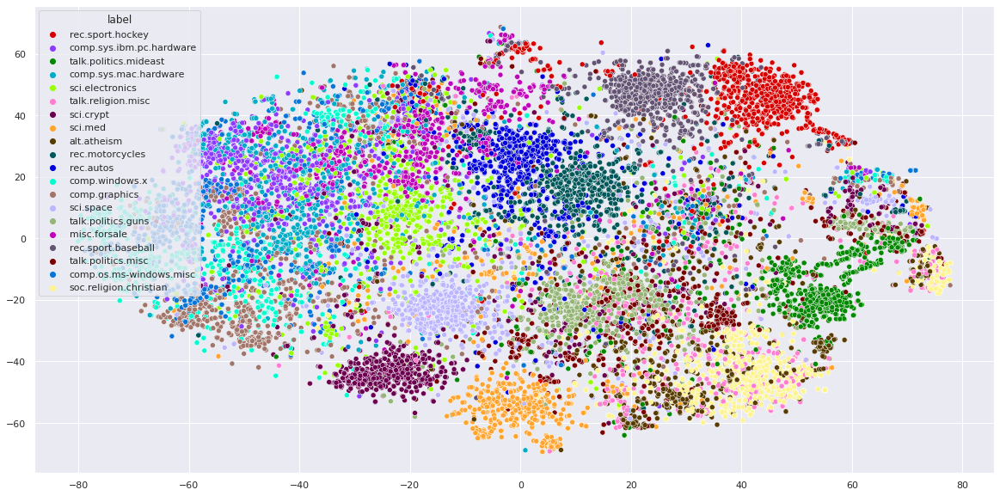

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=df['label'], palette=palette)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


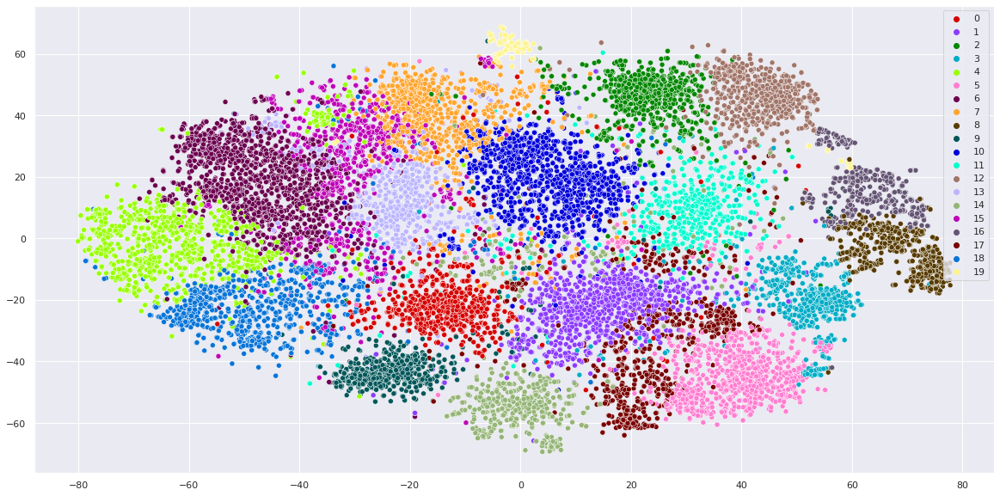

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=km.labels_, palette=palette)

In [ ]:
tsne = TSNE(n_components=3)
X_embedded_3D = tsne.fit_transform(X_new)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [ ]:
import plotly.express as px
fig_3d = px.scatter_3d(
    X_embedded_3D, x=0, y=1, z=2,
    color=df.label, labels={'color': 'label'}
)
fig_3d.update_traces(marker_size=2)

fig_3d.show()

In [ ]:
import plotly.express as px
fig_3d = px.scatter_3d(
    X_embedded_3D, x=0, y=1, z=2,
    color=km.labels_
)
fig_3d.update_traces(marker_size=2)

fig_3d.show()